# Analysis of sections

- Time mean and std plots along section for T,S, u_norm, u_along
- Mean seasonal cycle in sections
- Anomalies/Compsites plots
- Volume transport through sections (divided into SBJ and GS)
- SSS along 71W
- SBJ identification analysis (not completely here, details for Oleander in corresponding other notebook)

In [1]:
#Import import importants
import xarray as xr
import matplotlib.pyplot as plt
import numpy as np 
import math
import matplotlib.font_manager
import cmocean as cmo
from tqdm import tqdm
import cartopy.crs as ccrs
import os
from matplotlib import colors
from matplotlib.animation import FuncAnimation 
import xorca_brokenline as bl
import cartopy.crs as ccrs
import cartopy.feature as cfeature
from matplotlib.ticker import MaxNLocator
from matplotlib.colors import BoundaryNorm
from matplotlib import ticker

#Ignore warnings for now
import warnings
warnings.filterwarnings('ignore')

#Local path to respository (Change to your directory for code to work)
path_rp = '/home/milon.miah/Documents/'

os.chdir(path_rp + 'DV_NAshelf_NEMO/Scripts')
from worldmap import WorldMap
from calc import *
from util import *
os.chdir(path_rp)

#Plot parameters
plt.rcParams['font.size'] = 20.0

## Load data of sections
Optionally, the data can be cut off in depth

In [2]:
# Read Data of the three sections - Clidex directory
path_sections = '/vortex/clidex/data/NEMO/VIKING20X/sections/section_'

ds_71W =  xr.open_dataset(path_sections + '71W_incl_GS.nc')
ds_GoM = xr.open_dataset(path_sections + 'GoM_entrance_incl_GS.nc')
ds_OL = xr.open_dataset(path_sections + 'Oleander_incl_GS.nc')

#Cut off land mass
ds_71W = ds_71W.where(ds_71W != 0.0)
ds_GoM = ds_GoM.where(ds_GoM != 0.0)
ds_OL = ds_OL.where(ds_OL != 0.0)

#Cut off depth optionally
depth = 300
if depth != None:
    ds_71W = ds_71W.sel(z = slice(0, depth))
    ds_GoM = ds_GoM.sel(z = slice(0, depth))
    ds_OL = ds_OL.sel(z = slice(0, depth))

In [3]:
#Create some useful lists
prop = ['votemper', 'vosaline',  'u_rot_along', 'u_rot_normal']
titles = ['Temperature', 'Salinity', 'Velocity along', 'Velocity normal']
units = [' [°C]', ' [g/kg]', ' [m/s]', ' [m/s]']
cmap = ['cmo.thermal', 'cmo.haline', 'cmo.balance', 'cmo.balance']
labels = ['71W', 'GoM', 'OL']
ds = [ds_71W, ds_GoM, ds_OL]
time_periods = ['1960', '1968', '1986', '2012', '2019']

## Load data of SSH
SSH data is going to be used to study differences along jet axis

In [4]:
#Load data from mnt directory
ds_ssh = xr.open_dataset('/mnt/data/SSH/ssh_monthly.nc')

In [5]:
#Optionally take mean for plots later 
ds_ssh_mean = ds_ssh.mean(dim = 'time_counter')
ds_ssh_std = ds_ssh.std(dim = 'time_counter')

## Plot of overview map of the shelf

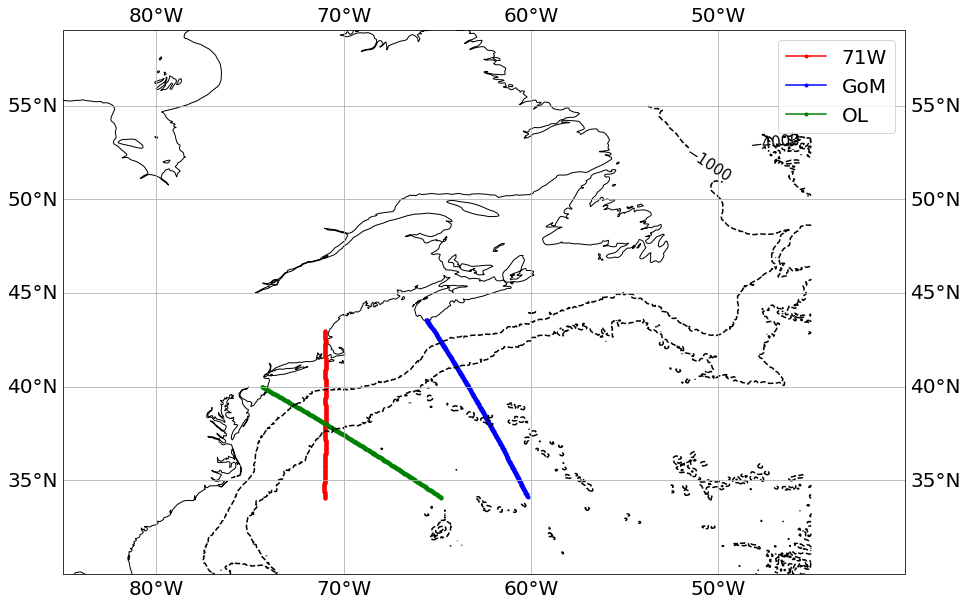

In [6]:
#Create Figure
fig = plt.figure(figsize = (20, 10))
ax = fig.add_subplot(1, 1, 1, projection=ccrs.PlateCarree())

#Create WorldMap from implemented module
atl = WorldMap(real_color = False, zoom = [-85, -40, 30, 57], ax = ax)

#Plot sections
atl.Ax.plot(ds_71W.lon, ds_71W.lat, color = 'r', marker = '.', ls = None, label ='71W')
atl.Ax.plot(ds_GoM.lon, ds_GoM.lat, color = 'b', marker = '.', ls = None, label ='GoM')
atl.Ax.plot(ds_OL.lon, ds_OL.lat, color = 'g', marker = '.', ls = None, label ='OL')

#Add bathymetry 
bthy1 = atl.add_bathymetry(-1000)
bthy2 = atl.add_bathymetry(-4000)
plt.legend()

#Save figure
fig.savefig(path_rp + 'DV_NAshelf_NEMO/Plots/Maps/sections.png')

## Time mean and standard deviation plots

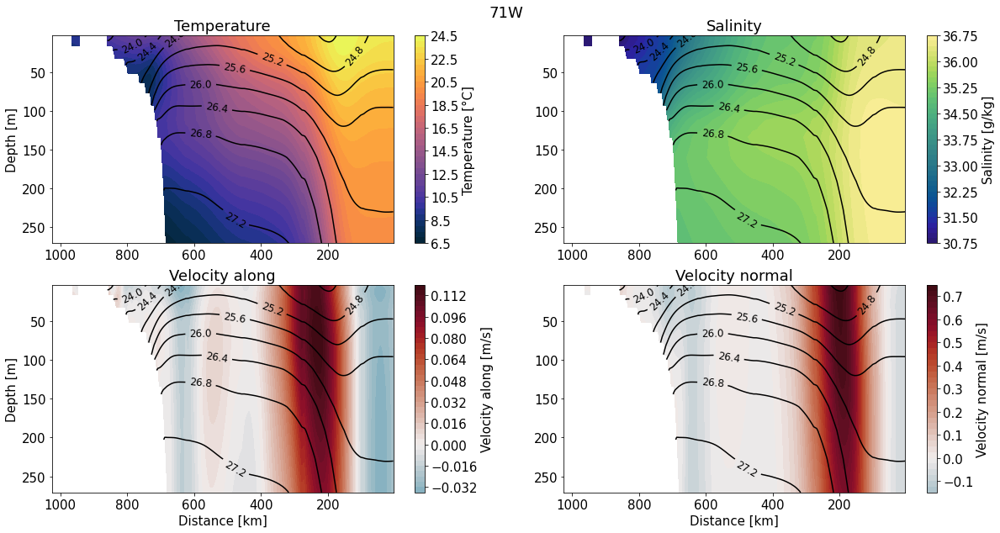

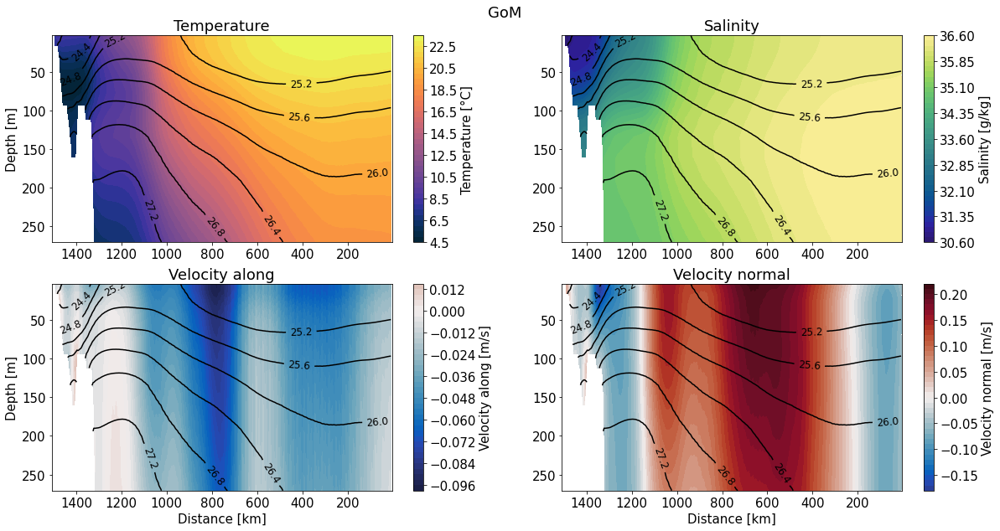

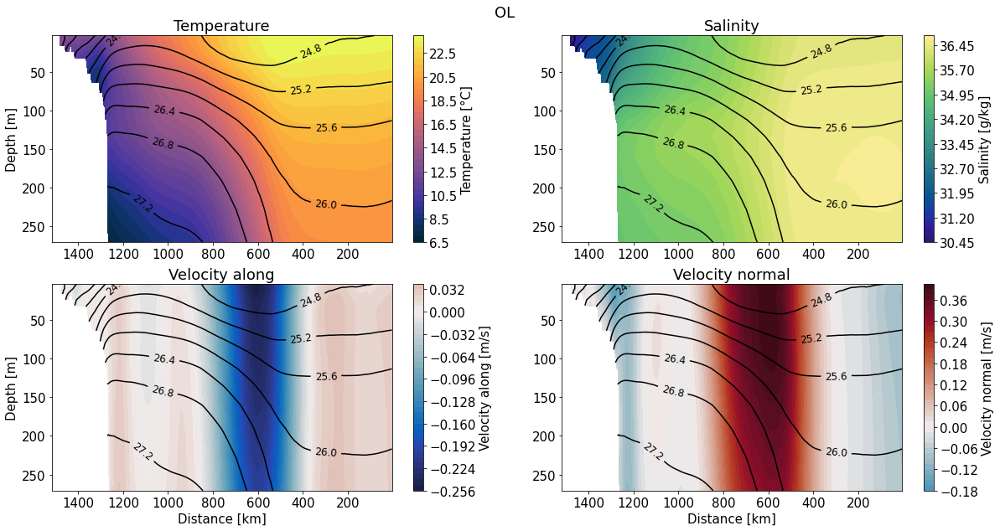

In [7]:
plt.rcParams['font.size'] = 15.0

#Take time-mean and plot T,S, u and v
#Calculate mean
ds_71W_mean = ds_71W.mean(dim = 'time_counter')
ds_GoM_mean = ds_GoM.mean(dim = 'time_counter')
ds_OL_mean = ds_OL.mean(dim = 'time_counter')
ds_mean = [ds_71W_mean, ds_GoM_mean, ds_OL_mean]

for j in range(len(ds_mean)):
    
    #Create subplots for each section
    i = 0
    fig, axes = plt.subplots(2,2, figsize = (20,10))
    fig.suptitle(labels[j], y = 0.93)

    for ax in axes.flat:
        
        #Create colormesh and make sure velocity colorbars are normalized
        if i >= 2:
            cmesh = ax.contourf(ds_mean[j].c/1e3, ds_mean[j].z, ds_mean[j][prop[i]], cmap = cmap[i], levels = 40, norm = colors.CenteredNorm())
        else:   
            cmesh = ax.contourf(ds_mean[j].c/1e3, ds_mean[j].z, ds_mean[j][prop[i]], cmap = cmap[i], levels = 40)
        
        fig.colorbar(cmesh, ax = ax, label = titles[i] + units[i], location = 'right')
        
        #Add density contour lines
        vertical_append(levels = 10, sec = ds_mean[j], axh = ax)
        
        #Add titles
        ax.title.set_text(titles[i])
        
        #Invert axes
        ax.invert_yaxis()
        ax.invert_xaxis()
        
        i += 1
    
    #Label axes
    for ax in axes[1,:]:
        ax.set_xlabel('Distance [km]')
    for ax in axes[:,0]:
        ax.set_ylabel('Depth [m]')
      
    
    #Save figure
    fig.savefig(path_rp + 'DV_NAshelf_NEMO/Plots/Sections/VerticalCuts/' + labels[j] + '_mean.png')

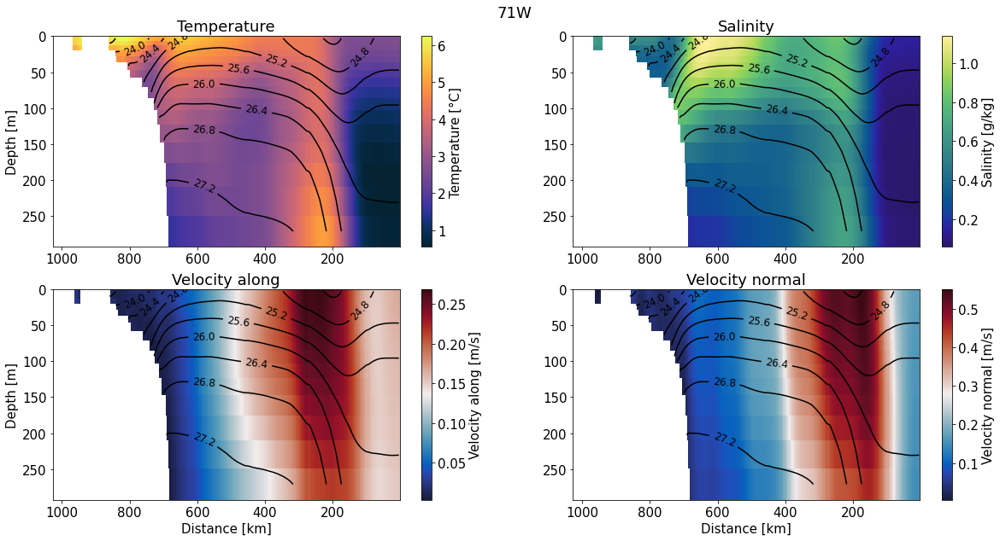

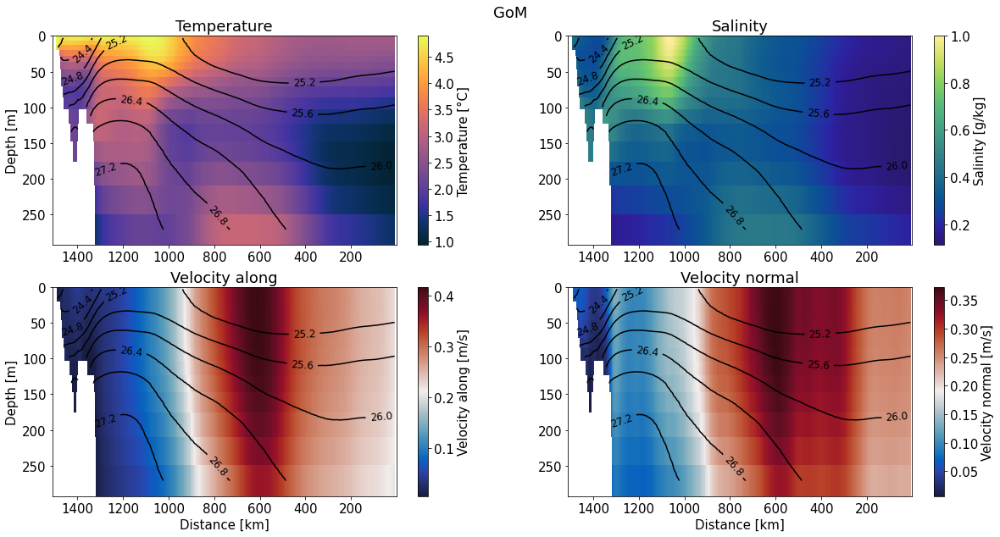

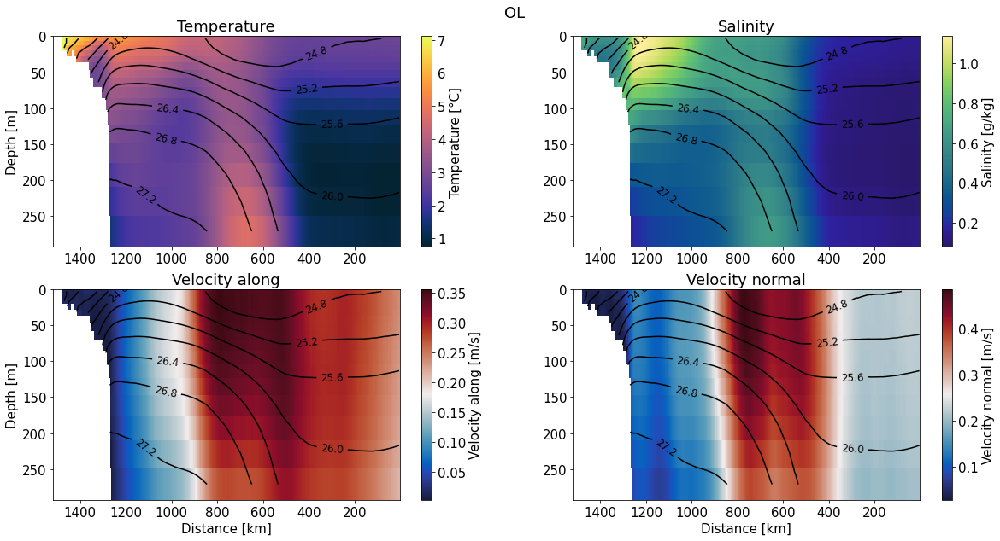

In [8]:
#Take time-std and plot T,S, u and v
ds_71W_std = ds_71W.std(dim = 'time_counter')
ds_GoM_std = ds_GoM.std(dim = 'time_counter')
ds_OL_std = ds_OL.std(dim = 'time_counter')
ds_std = [ds_71W_std, ds_GoM_std, ds_OL_std]

for j in range(len(ds_std)):
    
    #Create subplots for each section
    i = 0
    fig, axes = plt.subplots(2,2, figsize = (20,10))
    fig.suptitle(labels[j], y = 0.93)

    for ax in axes.flat:
        
        #Create colormesh
        cmesh = ax.pcolormesh(ds_std[j].c/1e3, ds_std[j].z, ds_std[j][prop[i]], cmap = cmap[i])             
        fig.colorbar(cmesh, ax = ax, label = titles[i] + units[i], location = 'right')
        
        #Set title and invert axes
        ax.title.set_text(titles[i])
        ax.invert_yaxis()
        ax.invert_xaxis()
        
        #Add density contour lines
        vertical_append(levels = 10, sec = ds_mean[j], axh = ax)
        i += 1
    
    #Label axes
    for ax in axes[1,:]:
        ax.set_xlabel('Distance [km]')
    for ax in axes[:,0]:
        ax.set_ylabel('Depth [m]')
        
    fig.savefig(path_rp + 'DV_NAshelf_NEMO/Plots/Sections/VerticalCuts/' + labels[j] + '_std.png')

## Time mean plots with SSH panels above

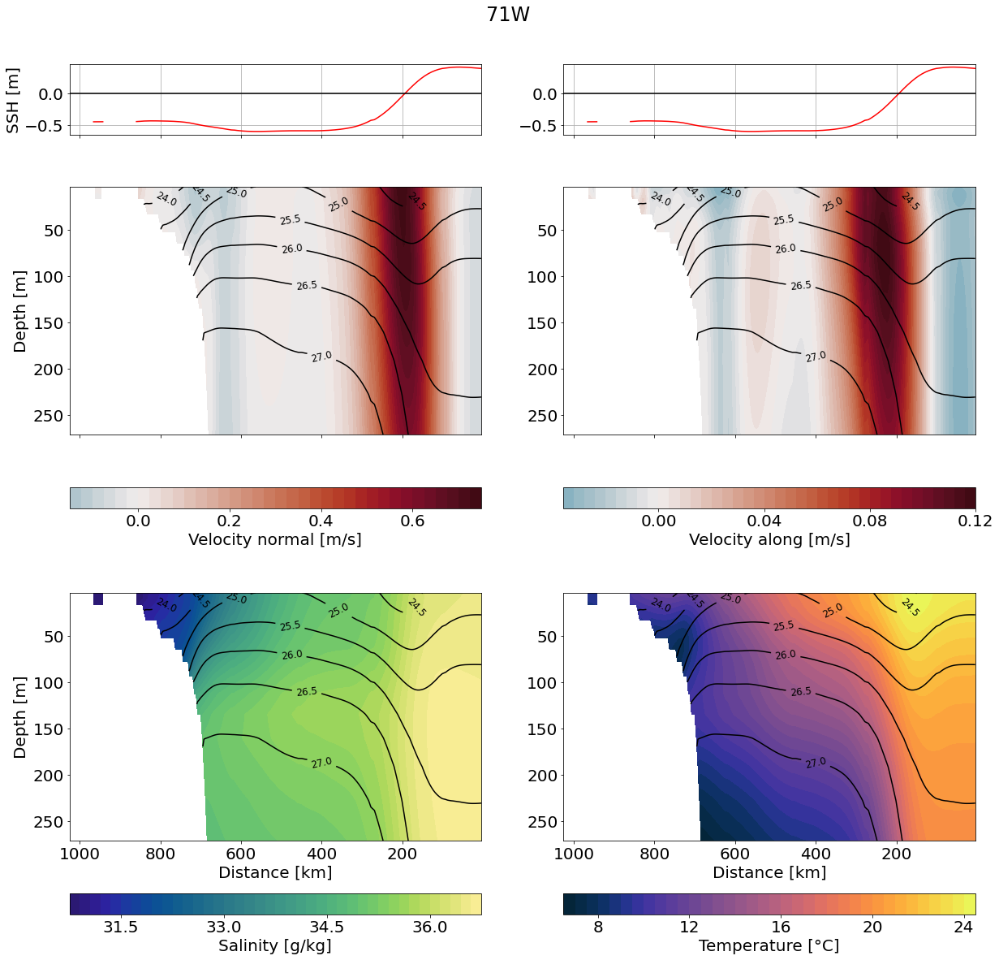

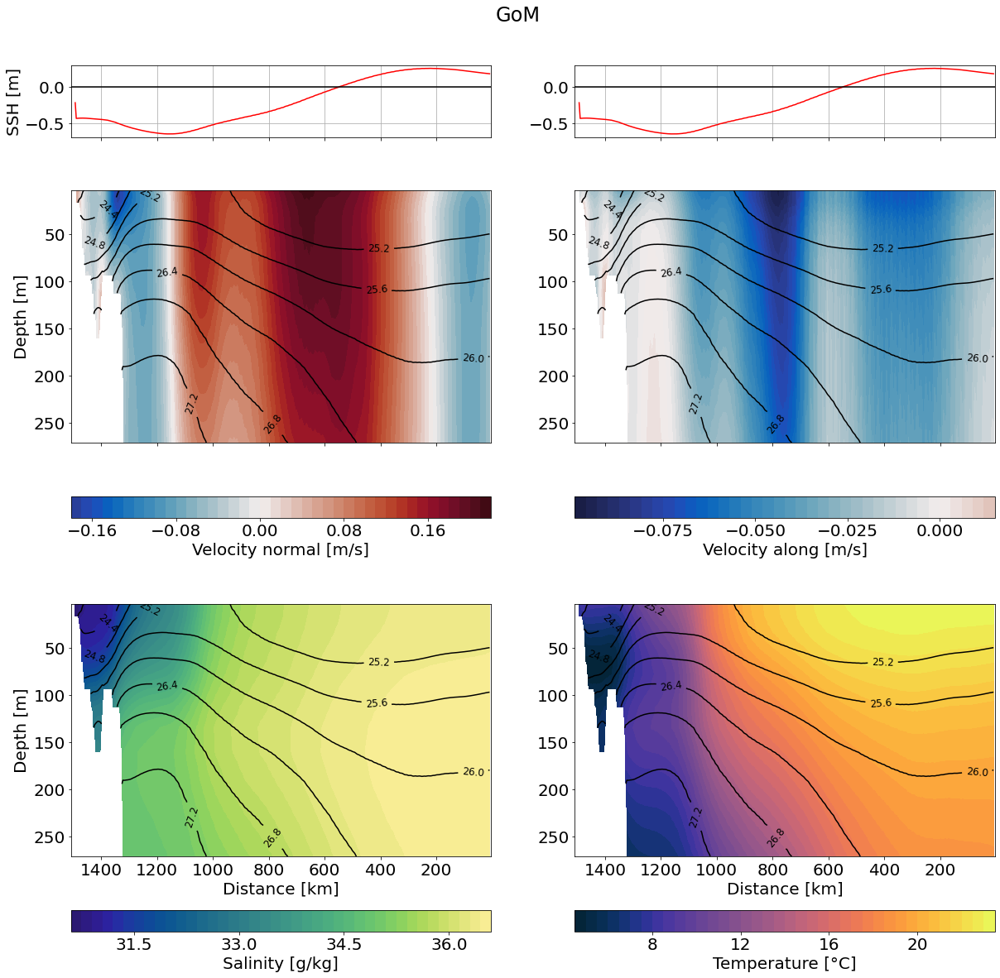

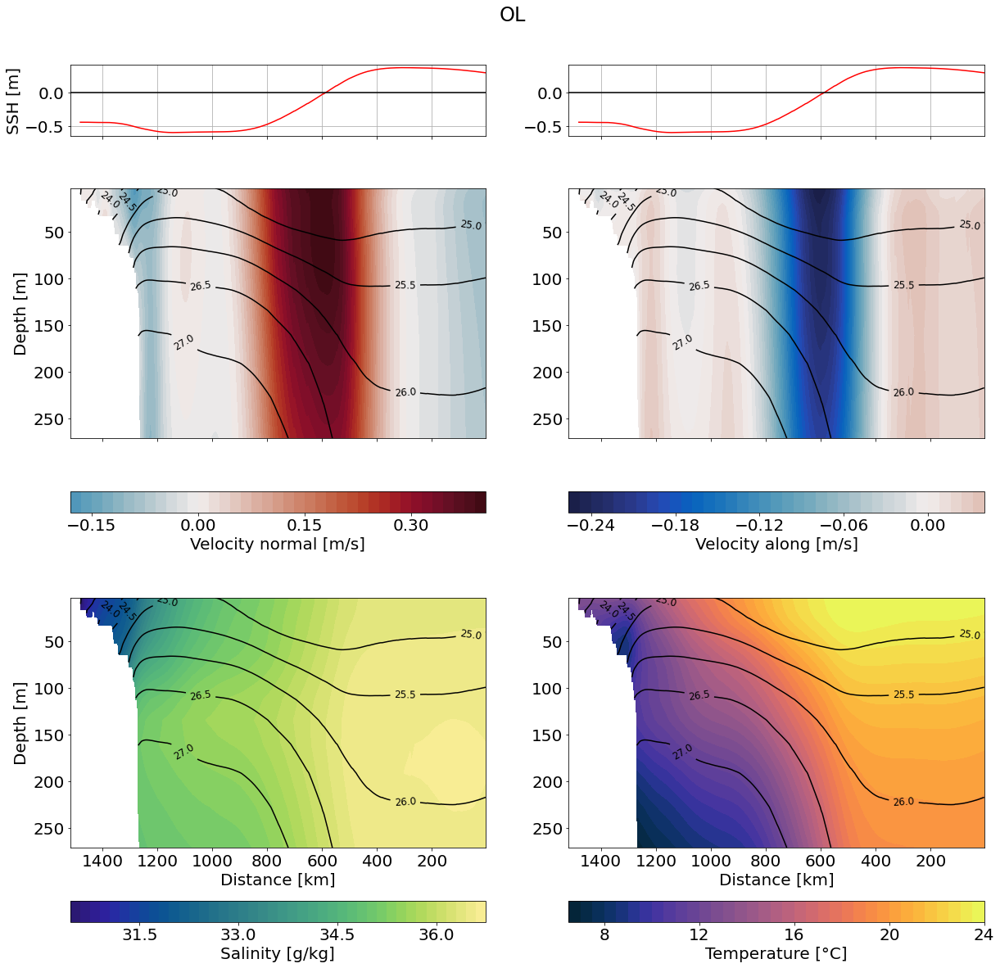

In [9]:
plt.rcParams['font.size'] = 20.0

cmap = ['cmo.thermal', 'cmo.haline', 'cmo.balance', 'cmo.balance']

for j in range(len(ds_mean)):
    
    #Define useful indices
    i = 0
    l = 3
    p = 0
    
    #Create figure
    fig, axes = plt.subplots(3, 2, figsize = (20,20), sharex = True, gridspec_kw={'height_ratios': [1, 5, 5]})
    fig.suptitle(labels[j], y = 0.93)
    
    #Create step by step subplot
    axes[0][0].invert_xaxis()
    for ax in axes.flat:
        
        #Condition for panels meant for colormesh plots
        if i > 1:
            if i >= 4:
                cmesh = ax.contourf(ds_mean[j].c/1e3, ds_mean[j].z, ds_mean[j][prop[l]], cmap = cmap[l], levels = 40)
            else:   
                cmesh = ax.contourf(ds_mean[j].c/1e3, ds_mean[j].z, ds_mean[j][prop[l]], cmap = cmap[l], levels = 40, norm = colors.CenteredNorm())
            
            cb = fig.colorbar(cmesh, ax = ax, label = titles[l] + units[l], location = 'bottom')
            
            #Reduce number of ticks of colorbar
            tick_locator = ticker.MaxNLocator(nbins=5)
            cb.locator = tick_locator
            cb.update_ticks()
            
            #Add density contour lines
            vertical_append(levels = 8, sec = ds_mean[j], axh = ax)
            
            #Invert axes
            ax.invert_yaxis() 
            
            
            l -= 1
        
        #Panels for SSH
        else:                    
            ax.plot(ds_mean[j].c/1e3, ds_mean[j].sossheig, color = 'r')
            ax.axhline(y = 0, color = 'black')
            #ax.title.set_text(titles[p])
            ax.grid()
            
            p += 1
        
        i += 1
    
    for ax in axes[2,:]:
        ax.set_xlabel('Distance [km]')
    
    axes[1,0].set_ylabel('Depth [m]')
    axes[2,0].set_ylabel('Depth [m]')  
    axes[0,0].set_ylabel('SSH [m]')

    
    fig.savefig(path_rp + 'DV_NAshelf_NEMO/Plots/Sections/VerticalCuts/' + labels[j] + '_mean_ssh.png')

## Time std plots with SSH panels above

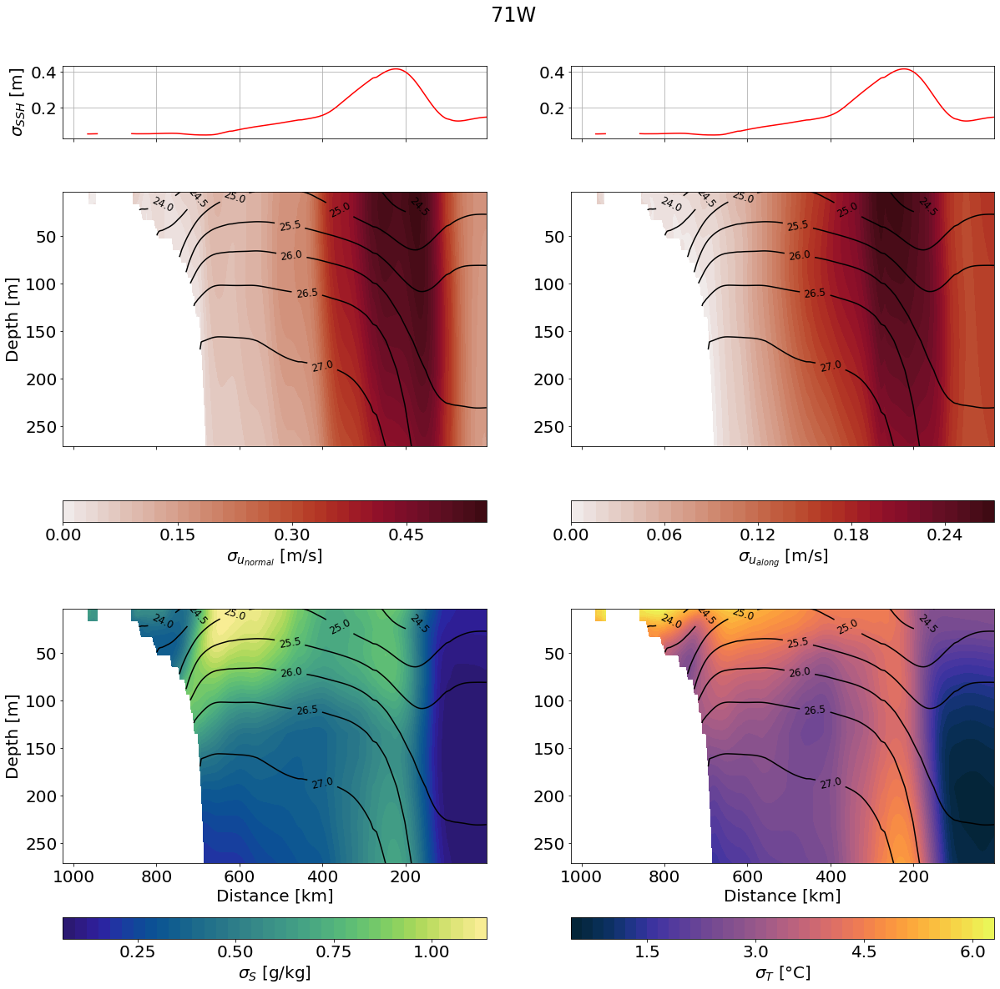

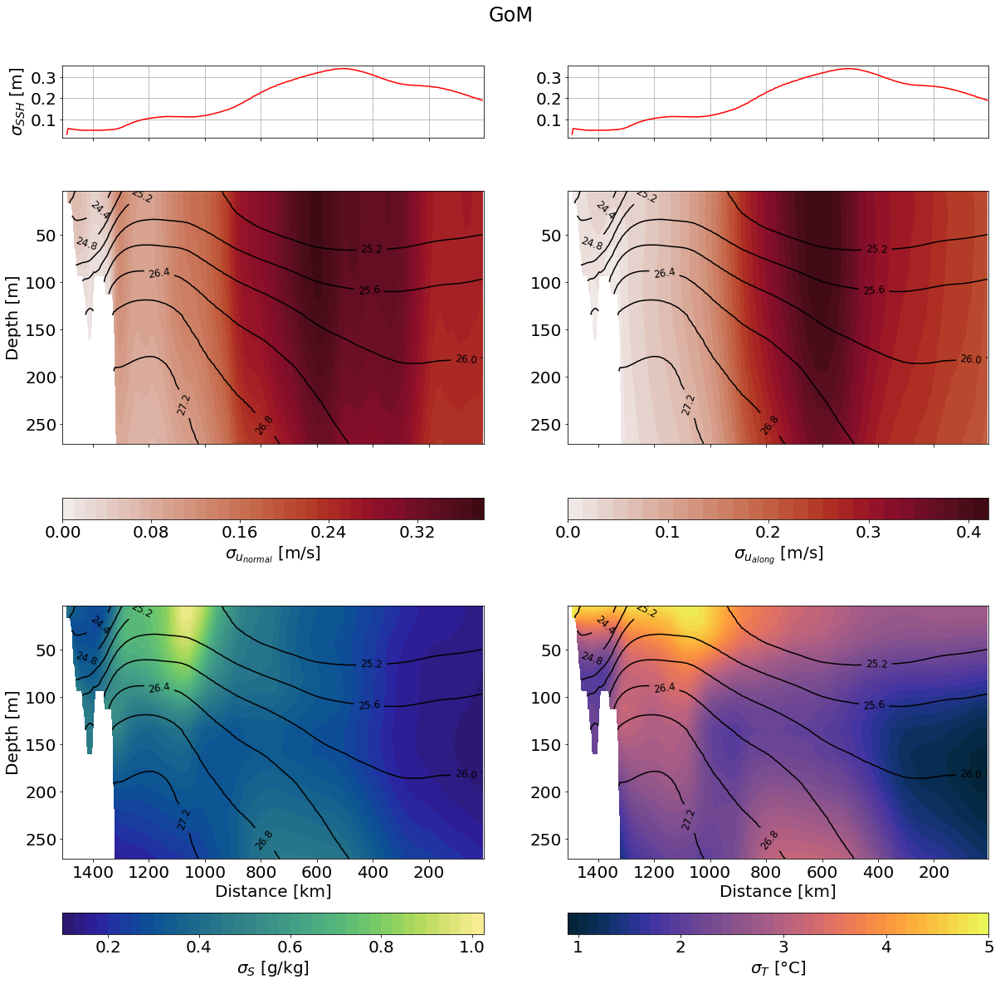

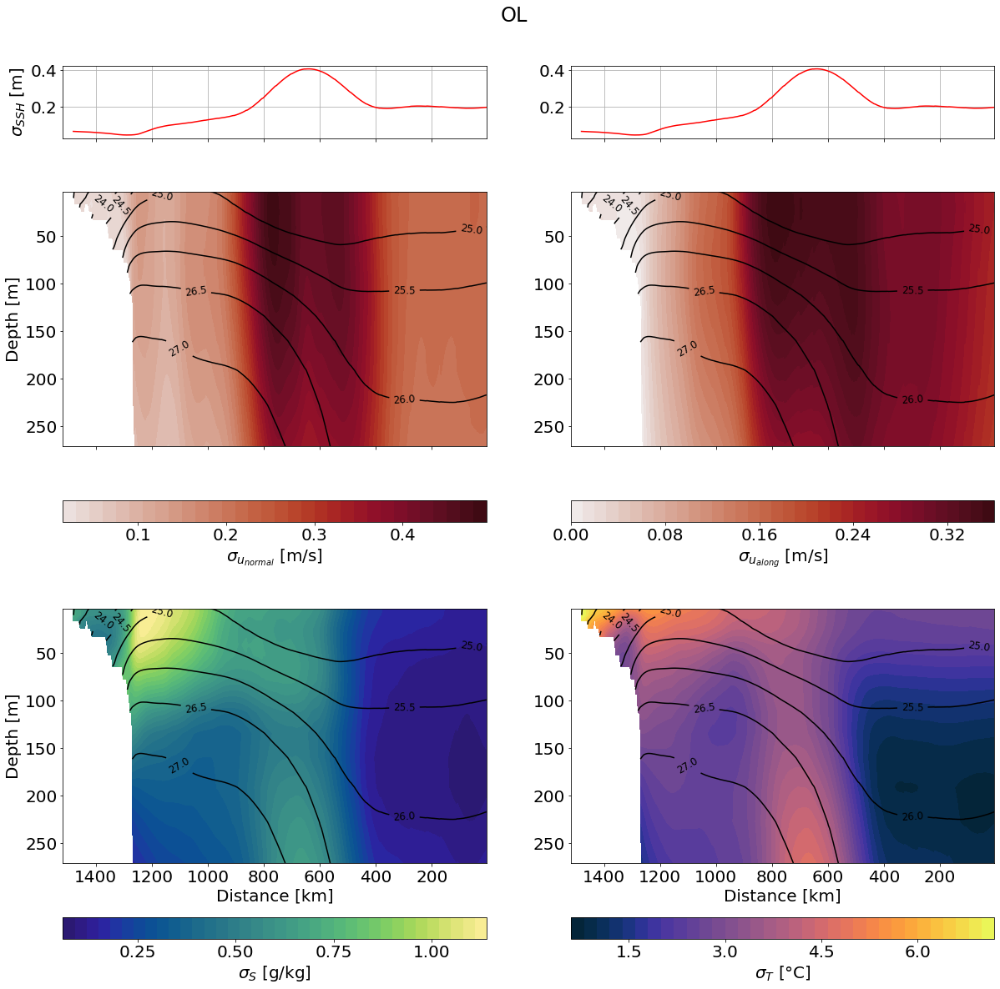

In [10]:
titles_std = ['$\u03C3_{T}$', '$\u03C3_{S}$', '$\u03C3_{u_{along}}$', '$\u03C3_{u_{normal}}$']
cmap = ['cmo.thermal', 'cmo.haline', 'cmo.balance', 'cmo.balance']

for j in range(len(ds_std)):
    
    #Define useful indices
    i = 0
    l = 3
    p = 0
    
    #Create figure
    fig, axes = plt.subplots(3, 2, figsize = (20,20), sharex = True, gridspec_kw={'height_ratios': [1, 5, 5]})
    fig.suptitle(labels[j], y = 0.93)
    
    #Create step by step subplot
    axes[0][0].invert_xaxis()
    for ax in axes.flat:
        
        #Condition for panels stdt for colormesh plots
        if i > 1:
            if i >= 4:
                cmesh = ax.contourf(ds_std[j].c/1e3, ds_std[j].z, ds_std[j][prop[l]], cmap = cmap[l], levels = 40)
            else:   
                cmesh = ax.contourf(ds_std[j].c/1e3, ds_std[j].z, ds_std[j][prop[l]], cmap = cmap[l], levels = 40, norm = colors.CenteredNorm())
            
            cb = fig.colorbar(cmesh, ax = ax, label = titles_std[l] + units[l], location = 'bottom')
            
            #Reduce number of ticks of colorbar
            tick_locator = ticker.MaxNLocator(nbins=5)
            cb.locator = tick_locator
            cb.update_ticks()
            
            #Add density contour lines
            vertical_append(levels = 8, sec = ds_mean[j], axh = ax)
            
            #Invert axes
            ax.invert_yaxis() 
            
            
            l -= 1
        
        #Panels for SSH
        else:                    
            ax.plot(ds_std[j].c/1e3, ds_std[j].sossheig, color = 'r')
            ax.grid()
            
            p += 1
        
        i += 1
    
    for ax in axes[2,:]:
        ax.set_xlabel('Distance [km]')
    
    axes[1,0].set_ylabel('Depth [m]')
    axes[2,0].set_ylabel('Depth [m]')  
    axes[0,0].set_ylabel('$\u03C3_{SSH}$ [m]')

    
    fig.savefig(path_rp + 'DV_NAshelf_NEMO/Plots/Sections/VerticalCuts/' + labels[j] + '_std_ssh.png')


## Mean seasonal cycles

In [11]:
#Group data for months
ds_group = []
for j in range(len(ds)):
    ds_group.append(ds[j].groupby('time_counter.month').mean(dim = 'time_counter'))

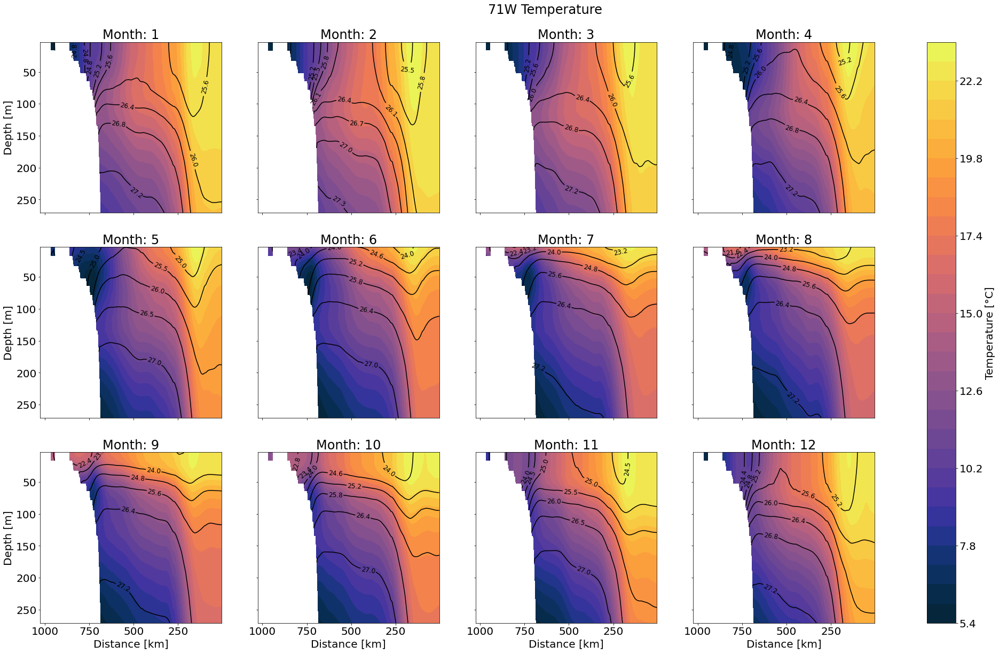

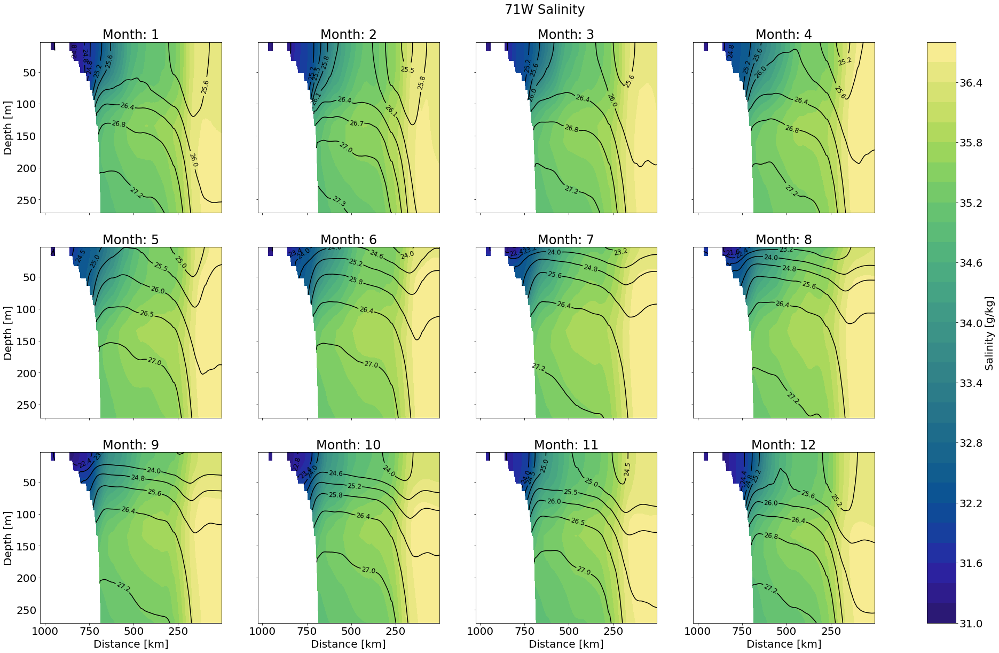

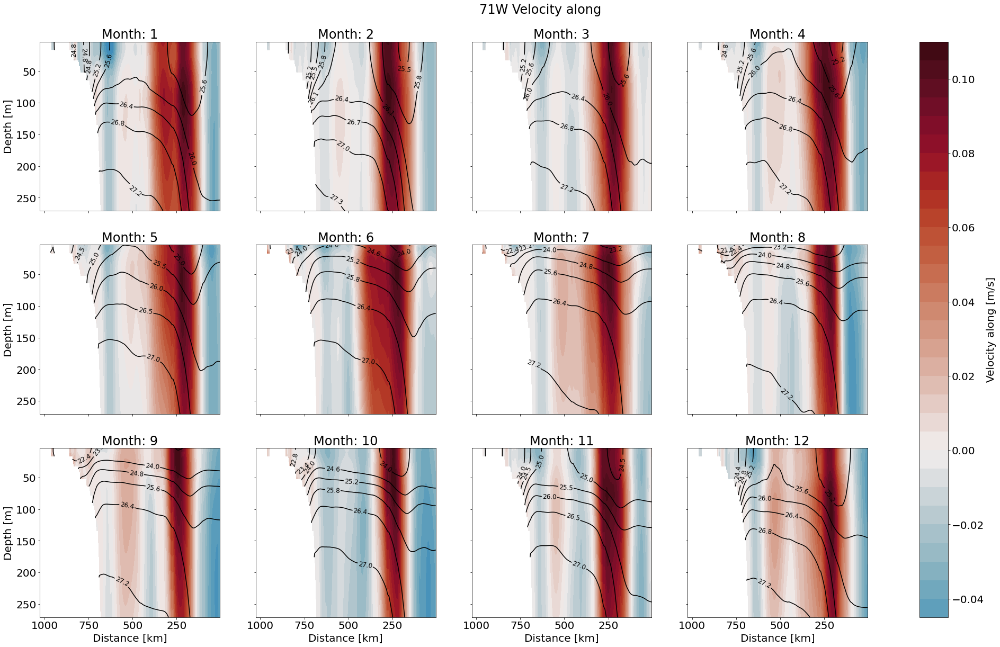

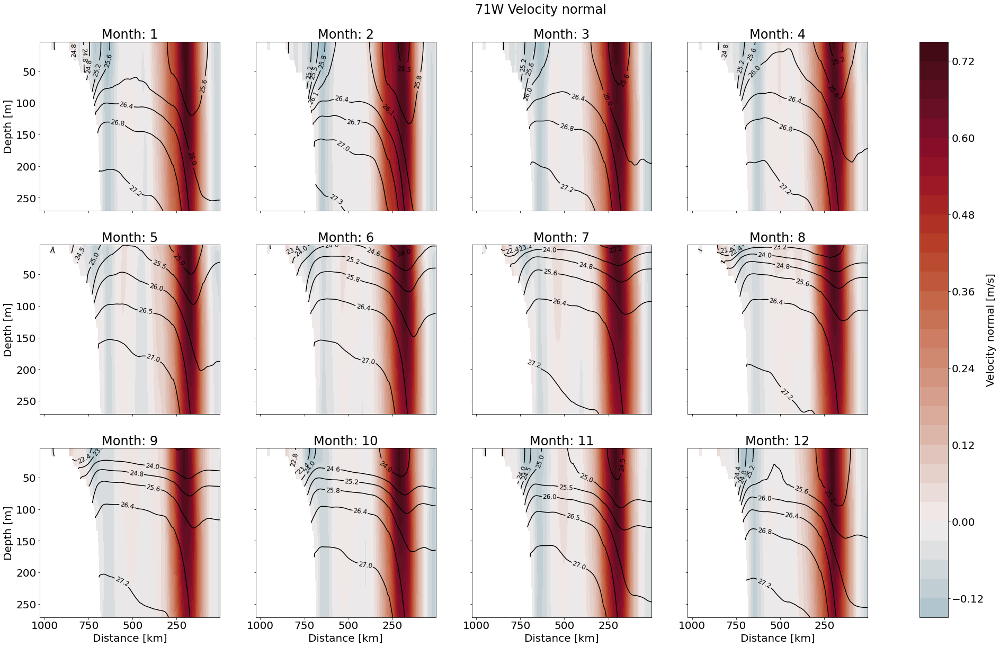

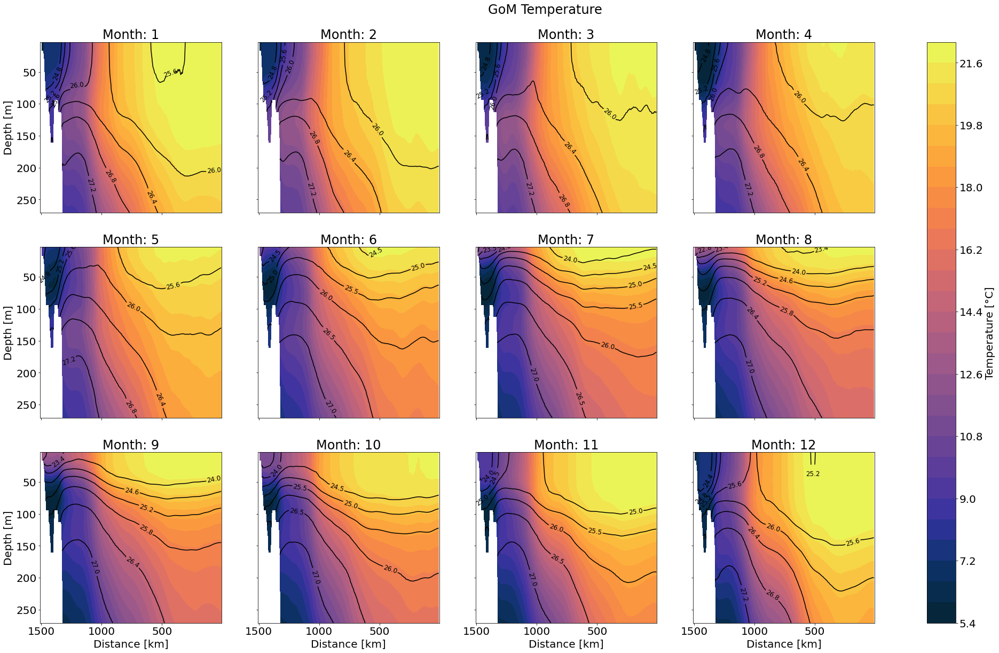

...

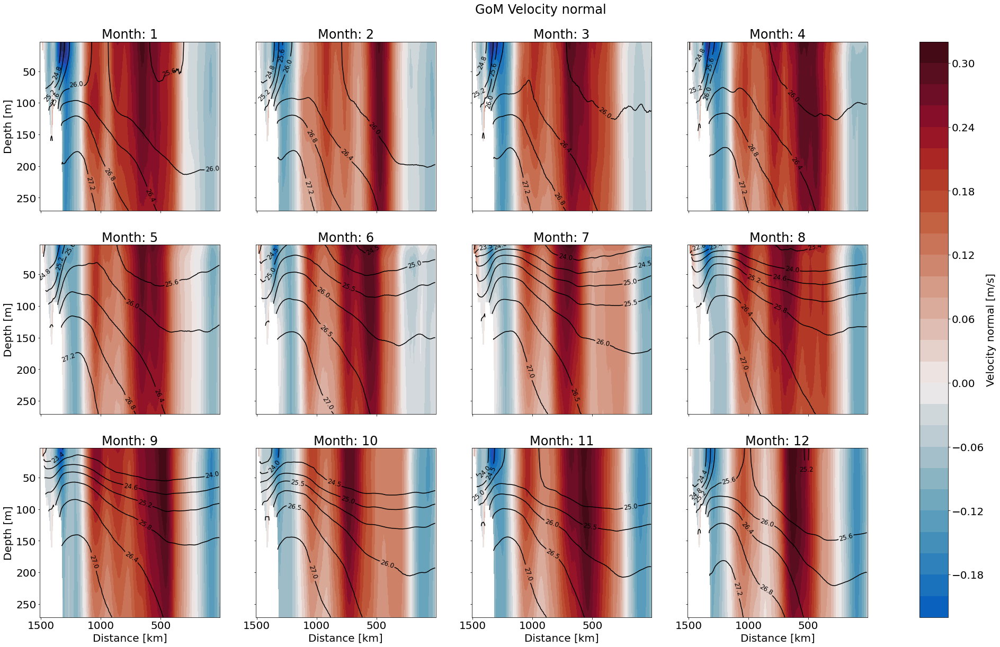

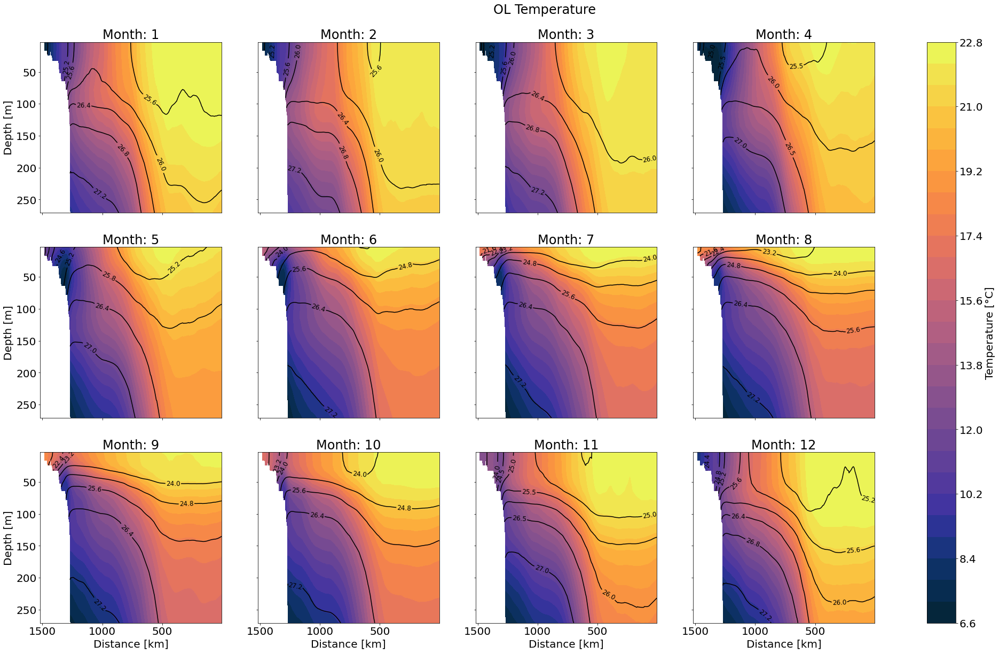

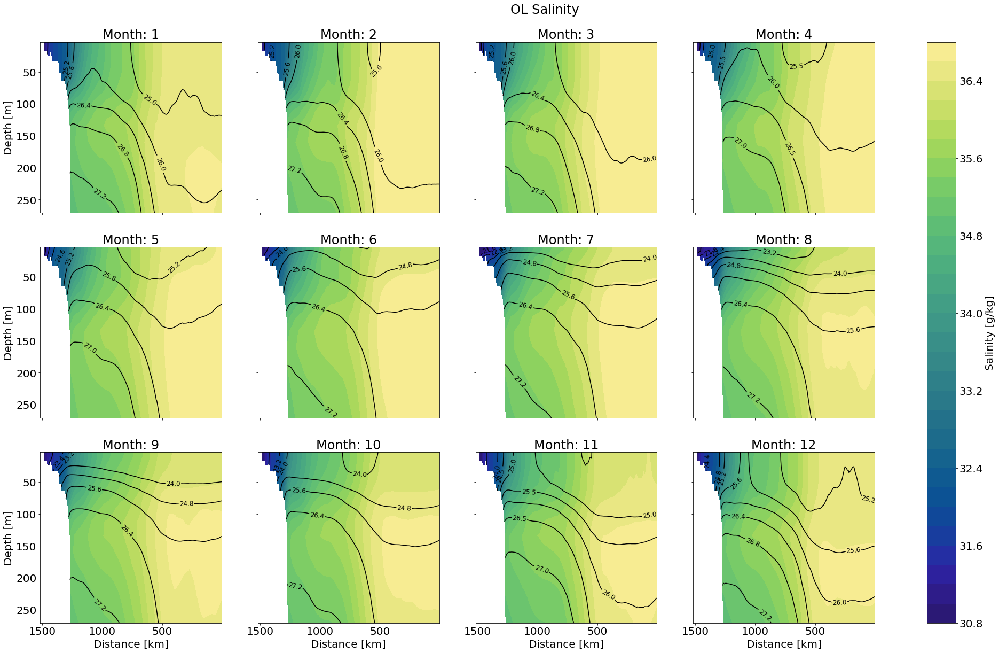

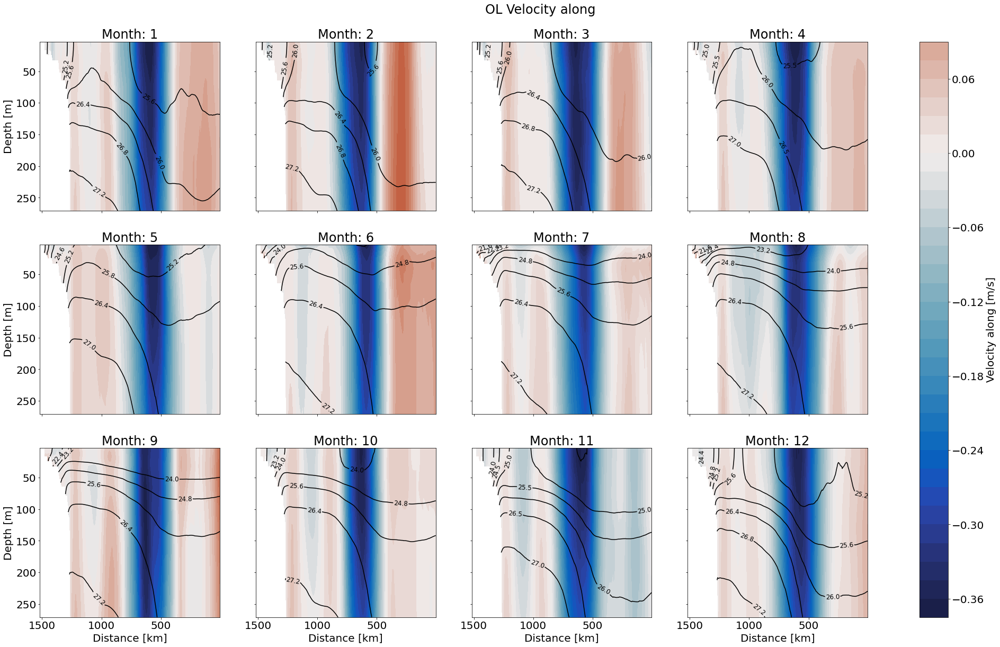

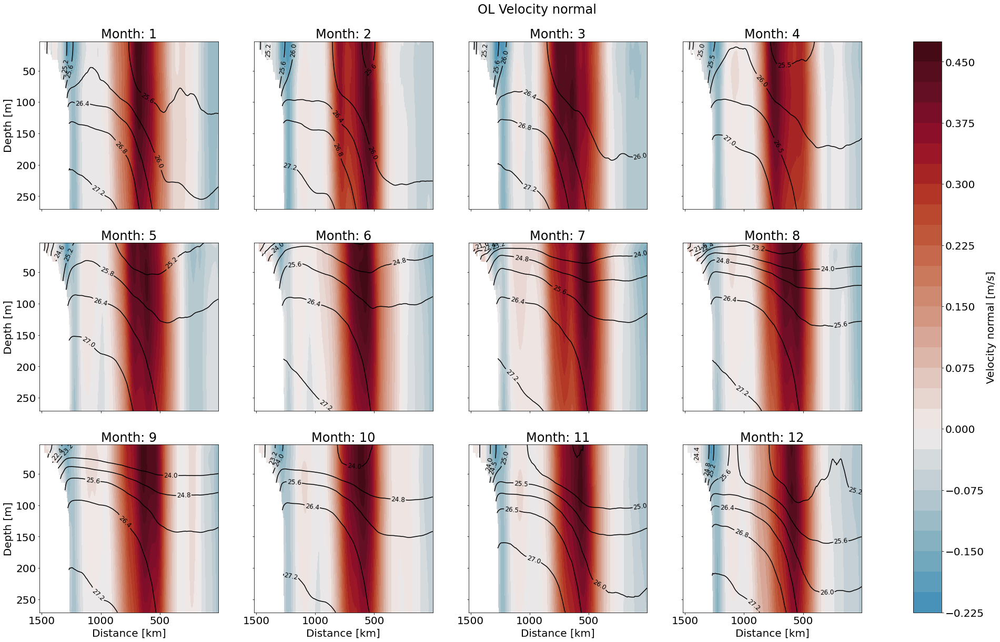

In [12]:
#Plot mean-seasonal cycle
cmap = ['cmo.thermal', 'cmo.haline', 'cmo.balance', 'cmo.balance']
for j in range(3):
    for i in range(4):
        
        fig, axes = plt.subplots(3, 4, figsize = (35,20), sharex = True, sharey = True)
        fig.suptitle(labels[j] + ' ' + titles[i], y = 0.93)
        
        k = 0
        axes[0][0].invert_xaxis()
        axes[0][0].invert_yaxis()
        for ax in axes.flat:
            if i >= 2:
                cmesh = ax.contourf(ds_group[j].c/1e3, ds_group[j].z, ds_group[j][prop[i]][k],
                                      cmap = cmap[i], norm = colors.CenteredNorm(), levels = 30) 
            else:
                cmesh = ax.contourf(ds_group[j].c/1e3, ds_group[j].z, ds_group[j][prop[i]][k], cmap = cmap[i], levels = 30)
            
            vertical_append(levels = 8, sec = ds_group[j].sel(month = k+1), axh = ax)
            ax.title.set_text('Month: {}'.format(k+1))

        
            k += 1
        
        for ax in axes[2,:]:
            ax.set_xlabel('Distance [km]')
        for ax in axes[:,0]:
            ax.set_ylabel('Depth [m]')
        
        fig.colorbar(cmesh, ax = axes, label = titles[i] + units[i], location = 'right')
        fig.savefig(path_rp + 'DV_NAshelf_NEMO/Plots/Sections/VerticalCuts/' + labels[j] + '_' + titles[i] + '_seas_cyc.png')

## Anomalies 
Firstly for desired time period, secondly for composites

In [13]:
#Deduct seasonal cycle from data
ds_ref = []
ds_anom = []
to_restore = ['ii', 'jj', 'lat', 'lon']
for j in range(3):
    
    #Choose data from 1990-2019, group per month and calculate mean
    ds_ref.append(ds[j].sel(time_counter = slice('01-01-1990', '31-12-2019')).groupby('time_counter.month').mean(dim = 'time_counter'))
    
    #Substract climatological cycle from data
    ds_anom.append(ds[j].groupby('time_counter.month') - ds_ref[j])
    
    for k in range(len(to_restore)):
        ds_anom[j][to_restore] = ds_ref[j][to_restore].mean('month')

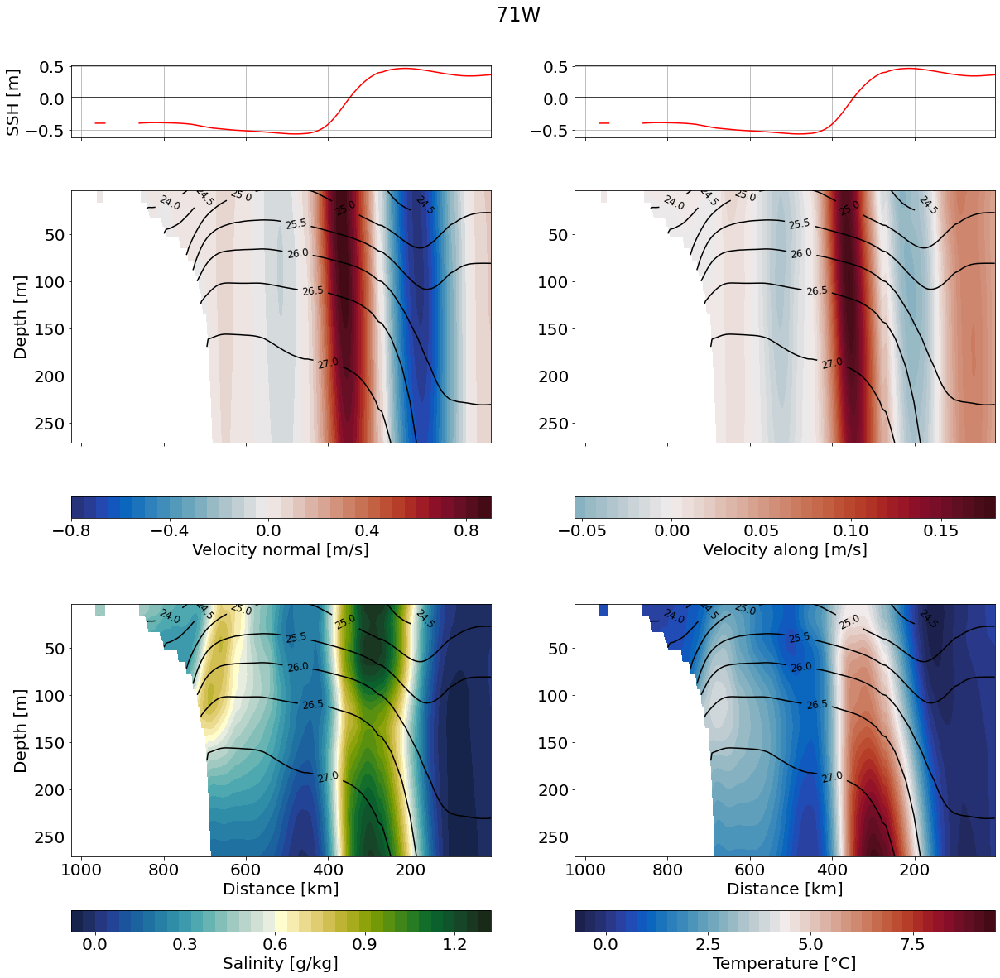

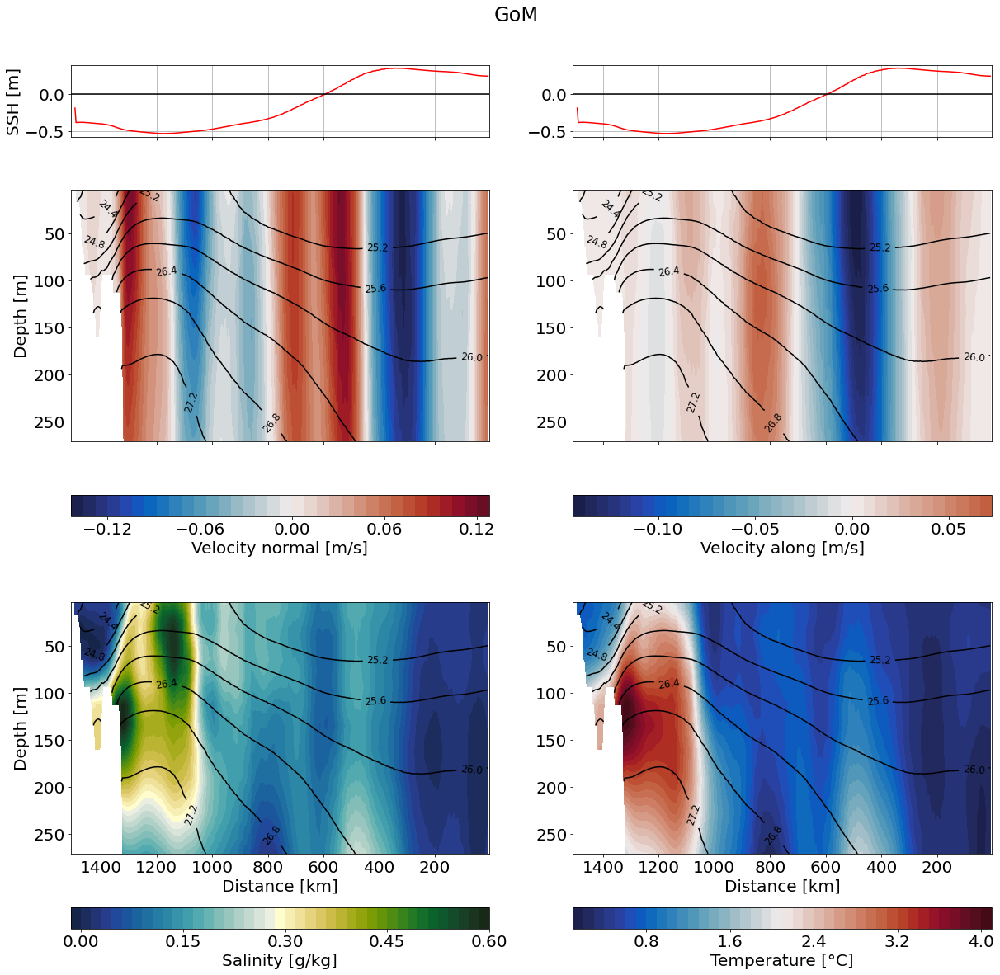

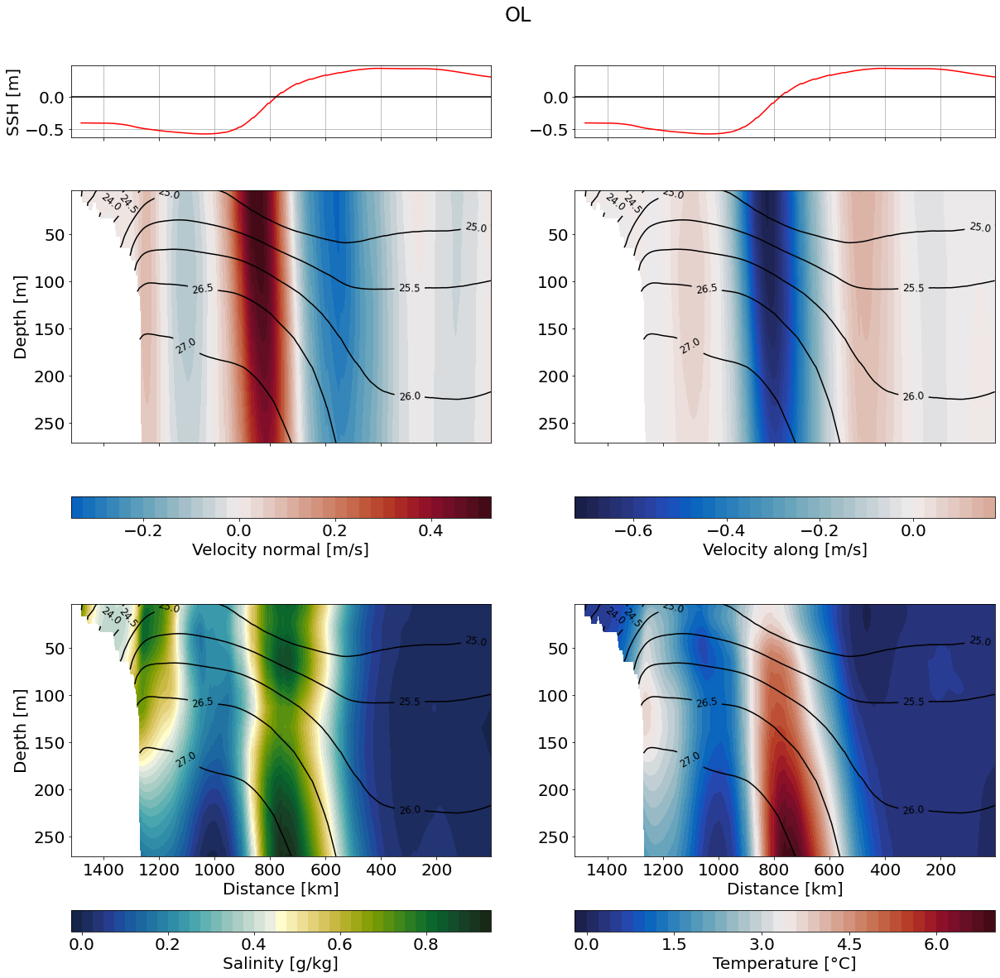

In [14]:
#Plot anomaly in certain time period
cmap = ['cmo.balance', 'cmo.delta', 'cmo.balance', 'cmo.balance']

#Choose time period
time_begin = np.datetime64('2015-01-16')
time_end = np.datetime64('2019-01-16')
time = slice(time_begin, time_end)

for j in range(len(ds_mean)):
    
    #Define useful indices
    i = 0
    l = 3
    p = 0
    
    #Create figure
    fig, axes = plt.subplots(3, 2, figsize = (20,20), sharex = True, gridspec_kw={'height_ratios': [1, 5, 5]})
    fig.suptitle(labels[j], y = 0.93)
    
    #Create step by step subplot
    axes[0][0].invert_xaxis()
    for ax in axes.flat:
        
        #Condition for panels meant for colormesh plots
        if i > 1:
            if i >= 4:
                cmesh = ax.contourf(ds_anom[j].c/1e3, ds_anom[j].z, ds_anom[j][prop[l]].sel(time_counter = time).mean(dim = 'time_counter'), cmap = cmap[l], levels = 40)
            else:   
                cmesh = ax.contourf(ds_anom[j].c/1e3, ds_anom[j].z, ds_anom[j][prop[l]].sel(time_counter = time).mean(dim = 'time_counter'), cmap = cmap[l], levels = 40, norm = colors.CenteredNorm())
            
            cb = fig.colorbar(cmesh, ax = ax, label = titles[l] + units[l], location = 'bottom')
            
            #Reduce number of ticks of colorbar
            tick_locator = ticker.MaxNLocator(nbins=5)
            cb.locator = tick_locator
            cb.update_ticks()
            
            #Add density contour lines
            vertical_append(levels = 8, sec = ds_mean[j], axh = ax)
            
            #Invert axes
            ax.invert_yaxis() 
            
            
            l -= 1
        
        #Panels for SSH
        else:                    
            ax.plot(ds[j].c/1e3, ds[j]['sossheig'].sel(time_counter = time).mean(dim = 'time_counter'), color = 'r')
            ax.axhline(y = 0, color = 'black')
            #ax.title.set_text(titles[p])
            ax.grid()
            
            p += 1
        
        i += 1
    
    for ax in axes[2,:]:
        ax.set_xlabel('Distance [km]')
    
    axes[1,0].set_ylabel('Depth [m]')
    axes[2,0].set_ylabel('Depth [m]')  
    axes[0,0].set_ylabel('SSH [m]')

    
    fig.savefig(path_rp + 'DV_NAshelf_NEMO/Plots/Sections/VerticalCuts/' + labels[j] + '_mean_ssh.png')

## Composites
First split data in time periods and subsequently take the average

In [15]:
#Calculate means in composites
ds_periods_mean = {}
ds_periods_anom = {}
ds_ssh = {}
for j in range(len(time_periods) - 1):
    for i in range(3):
        #Display either anomalies or pure data
        ds_periods_mean[labels[i] + ':' + time_periods[j] + '-' + time_periods[j+1]] = ds[i].sel(time_counter = slice(time_periods[j], time_periods[j+1])).mean(dim = 'time_counter')
        ds_periods_anom[labels[i] + ':' + time_periods[j] + '-' + time_periods[j+1]] = ds_anom[i].sel(time_counter = slice(time_periods[j], time_periods[j+1])).mean(dim = 'time_counter')
        ds_ssh[labels[i] + ':' + time_periods[j] + '-' + time_periods[j+1]] = ds[i].sel(time_counter = slice(time_periods[j], time_periods[j+1])).mean(dim = 'time_counter')['sossheig']

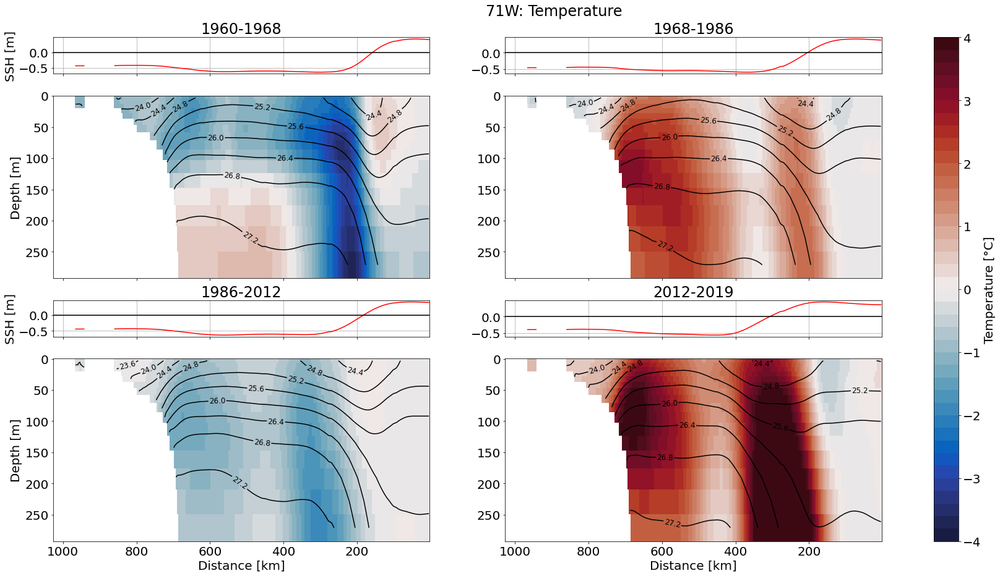

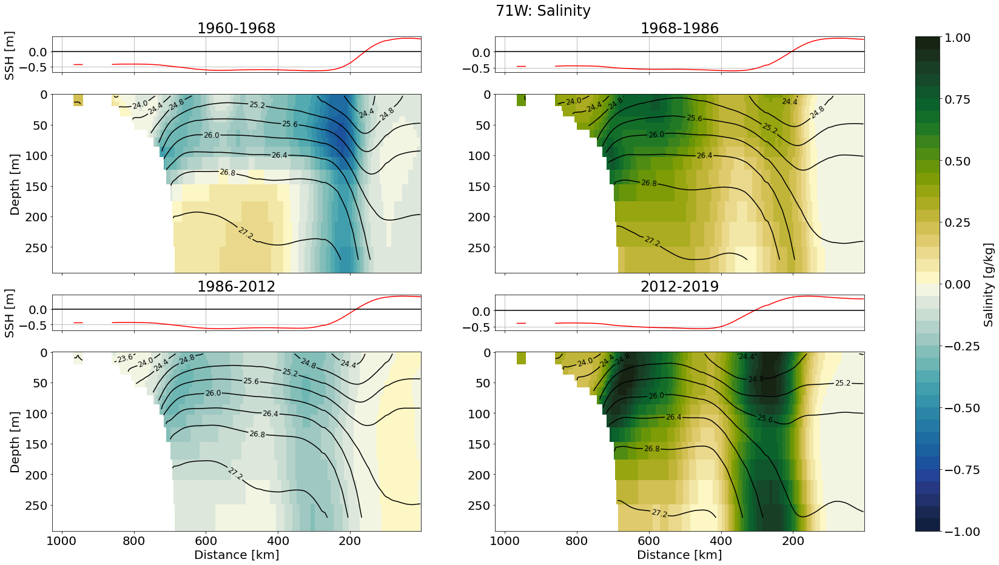

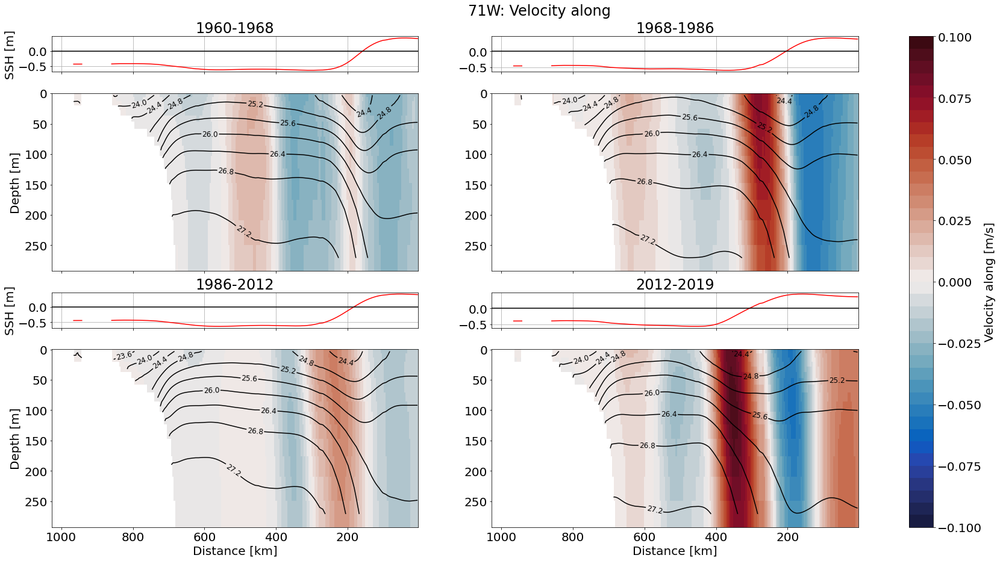

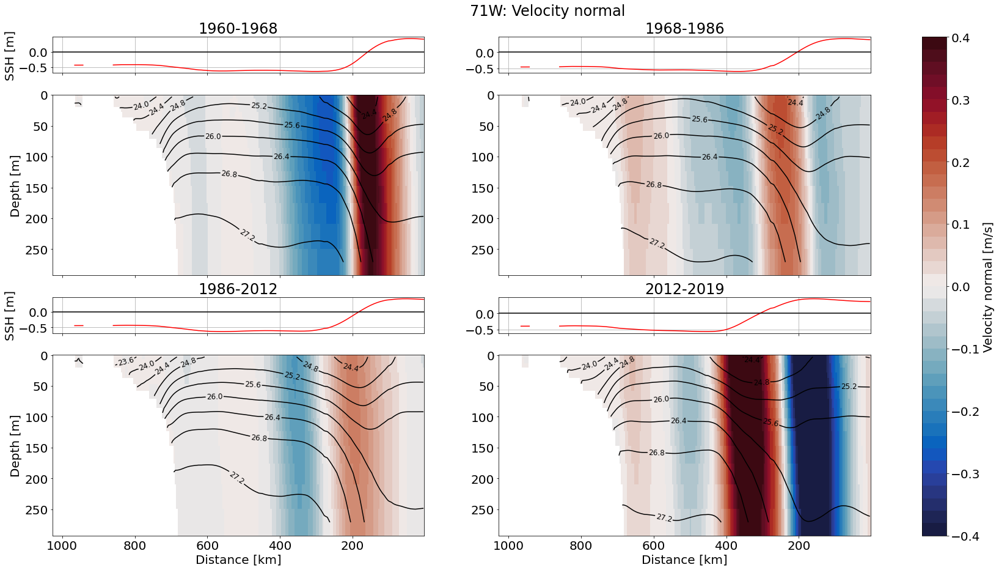

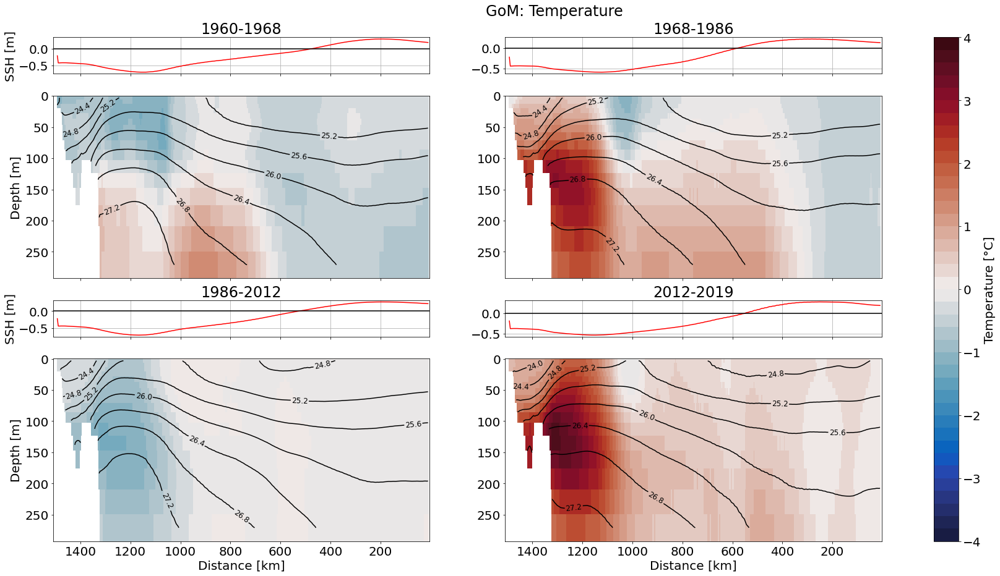

...

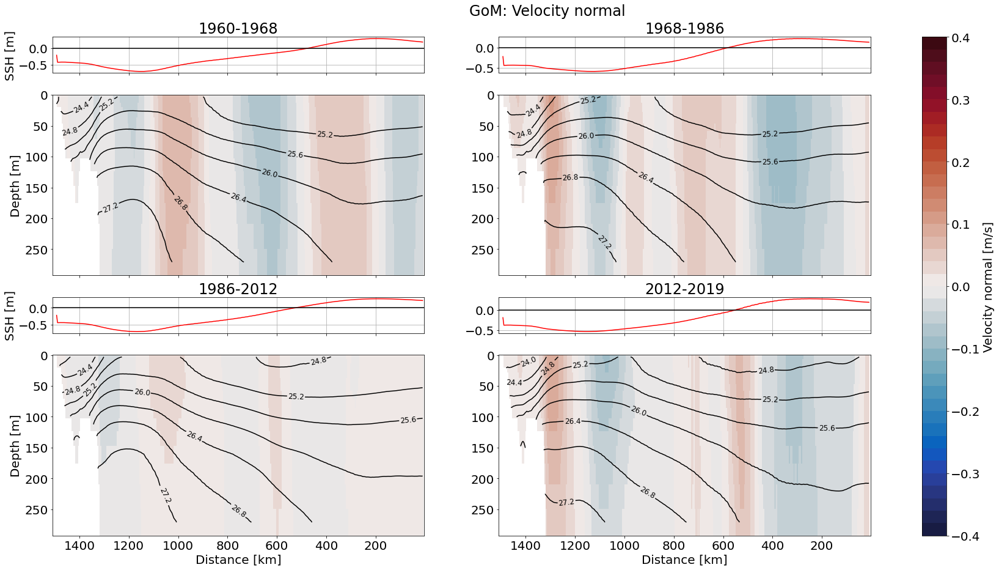

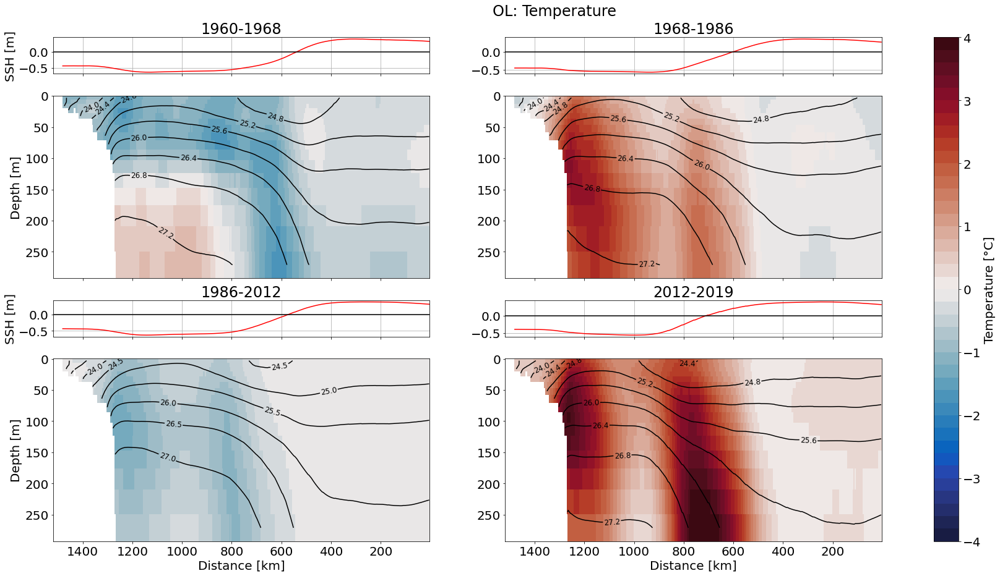

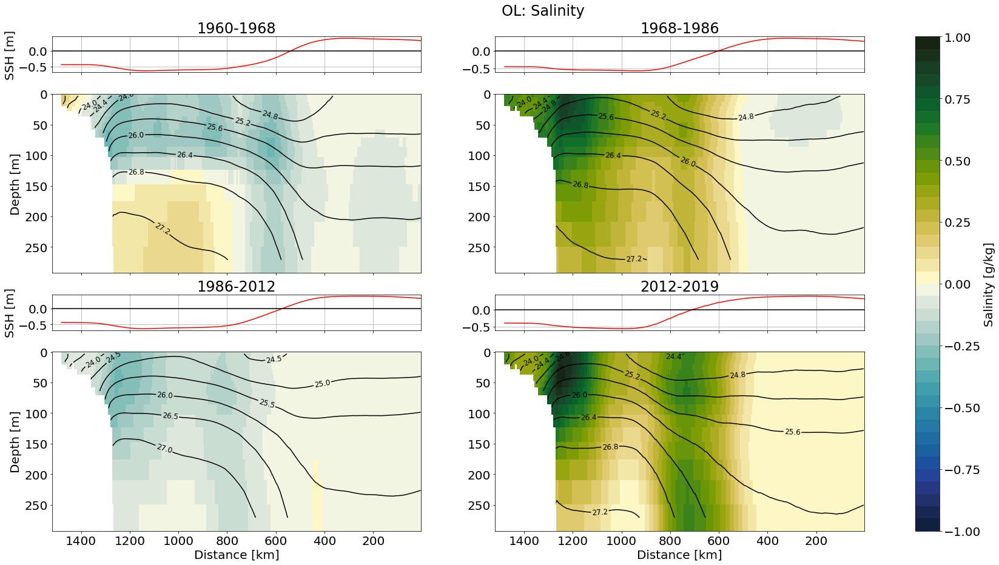

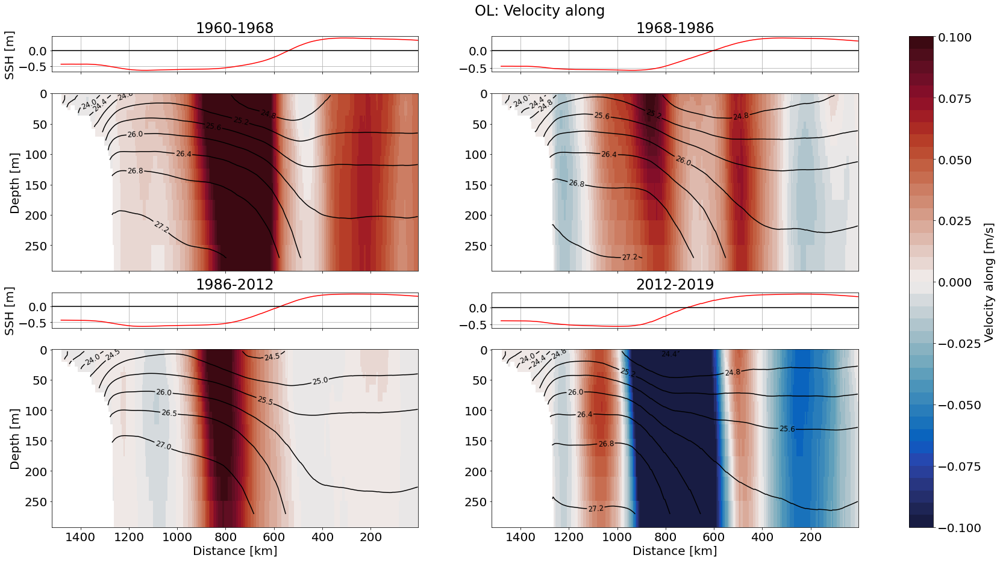

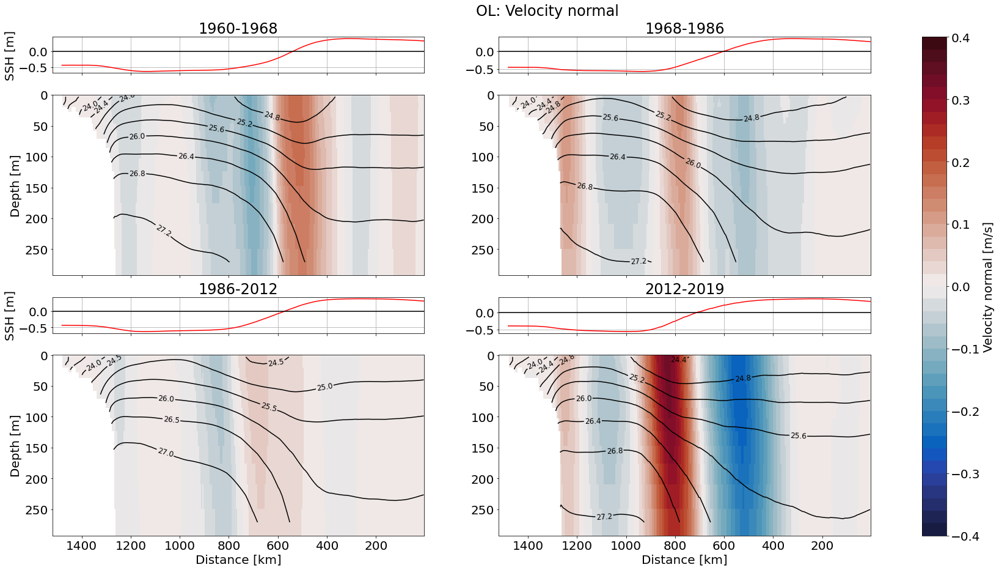

In [16]:
#Consider now time periods with composites of decadal variability
#Plot anomalies 
v = [4, 1, 0.1, 0.4]
plt.rcParams['font.size'] = 20.0
cmap = [cmo.cm.balance, cmo.cm.delta, cmo.cm.balance, cmo.cm.balance]

for i in range(len(ds)):
    for k in range(4):
        
        #Create figures
        fig, axes = plt.subplots(4, 2, figsize = (30,15), sharex = True, gridspec_kw={'height_ratios': [1, 5, 1, 5]}) 
        fig.suptitle(labels[i] + ': ' + titles[k], y = 0.93)
        
        j = 0
        p = 0
        l = 0
        axes[0][0].invert_xaxis()
        for ax in axes.flat:
            if j % 4 == 2 or j % 4 == 3:
                
                ax.invert_yaxis()
                levels = MaxNLocator(nbins=40).tick_values(-v[k], v[k])
                norm = BoundaryNorm(levels, ncolors=cmap[k].N, clip=True)

                cmesh = ax.pcolormesh(ds_periods_anom[labels[i] + ':' + time_periods[l] + '-' + time_periods[l+1]].c/1e3,
                                    ds_periods_anom[labels[i] + ':' + time_periods[l] + '-' + time_periods[l+1]].z,
                                    ds_periods_anom[labels[i] + ':' + time_periods[l] + '-' + time_periods[l+1]][prop[k]],
                                    cmap = cmap[k], norm = norm)
         
                #Add density contour lines
                vertical_append(levels = 10, sec = ds_periods_mean[labels[i] + ':' + time_periods[l] + '-' + time_periods[l+1]],
                axh = ax)
                l += 1
    
            else: 
                ax.title.set_text(time_periods[p] + '-' + time_periods[p+1])
                ax.plot(ds_periods_anom[labels[i] + ':' + time_periods[p] + '-' + time_periods[p+1]].c/1e3,
                        ds_ssh[labels[i] + ':' + time_periods[p] + '-' + time_periods[p+1]], 
                        color = 'red')
                ax.grid()
                ax.axhline(y = 0, color = 'black')
                p += 1
            
            j += 1
            
        cbar = fig.colorbar(cmesh, ax = axes, label = titles[k] + units[k], location = 'right')
            
        #Label axes
        for ax in axes[3,:]:
            ax.set_xlabel('Distance [km]')
        for ax in axes[1::2, 0]:
            ax.set_ylabel('Depth [m]')   
        for ax in axes[::2, 0]:
            ax.set_ylabel('SSH [m]')   
        
        #Save figures
        fig.savefig(path_rp + 'DV_NAshelf_NEMO/Plots/Sections/VerticalCuts/' + titles[k] + '_comp_anom' + labels[i] + '.png')


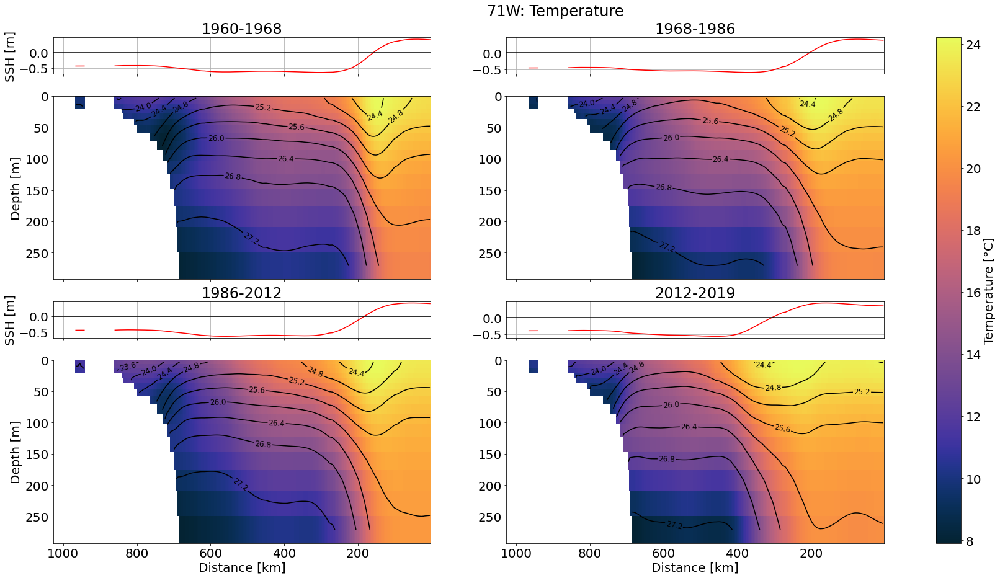

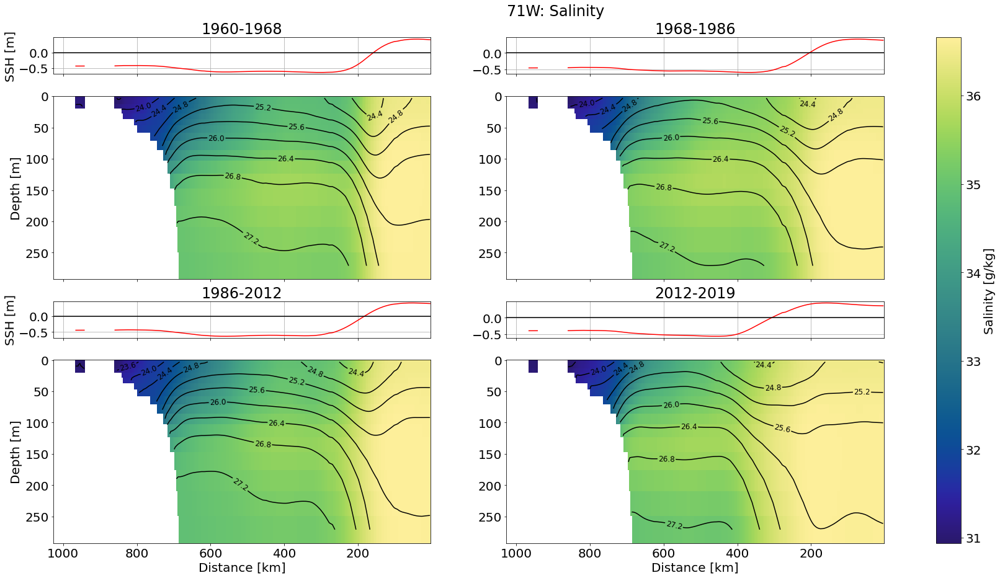

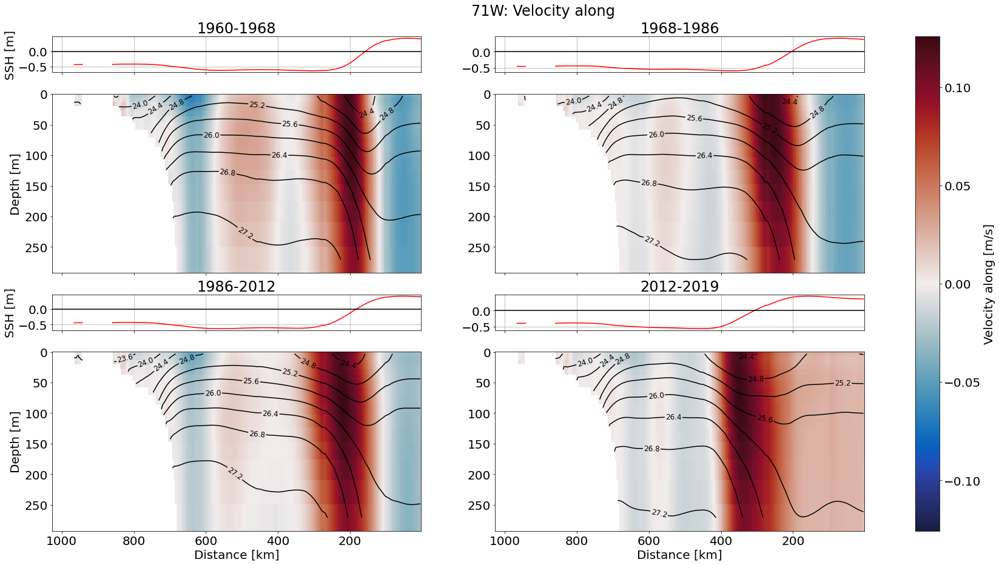

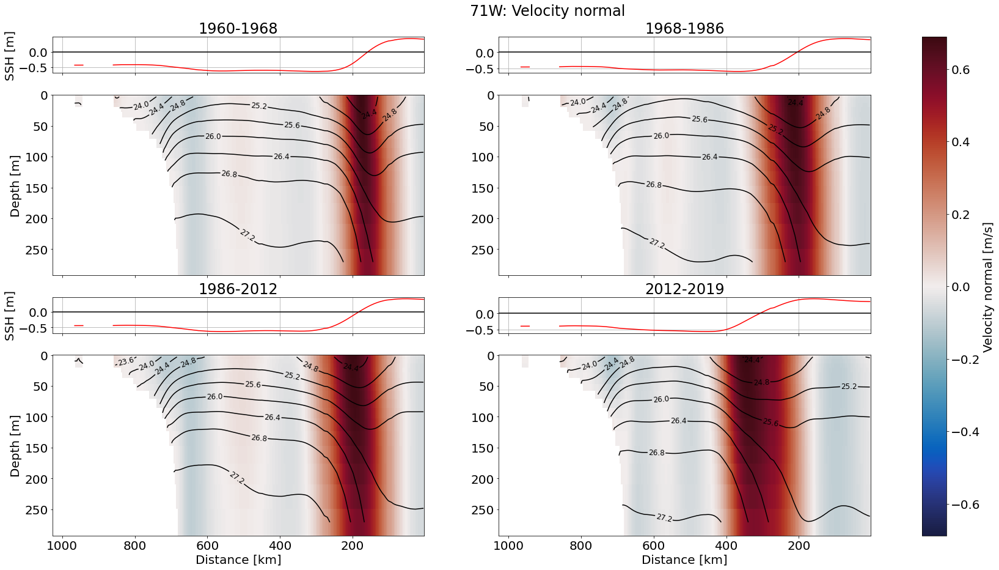

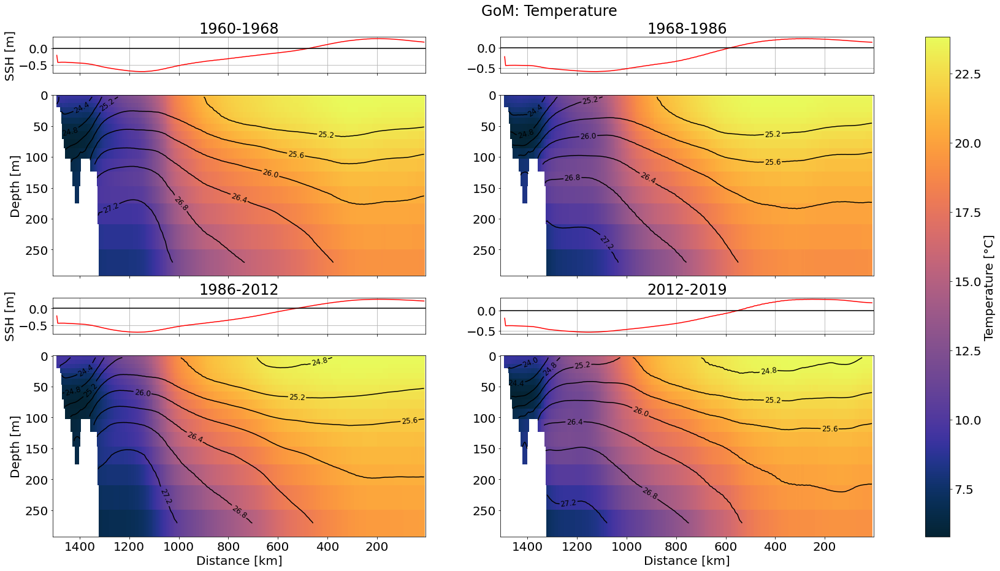

...

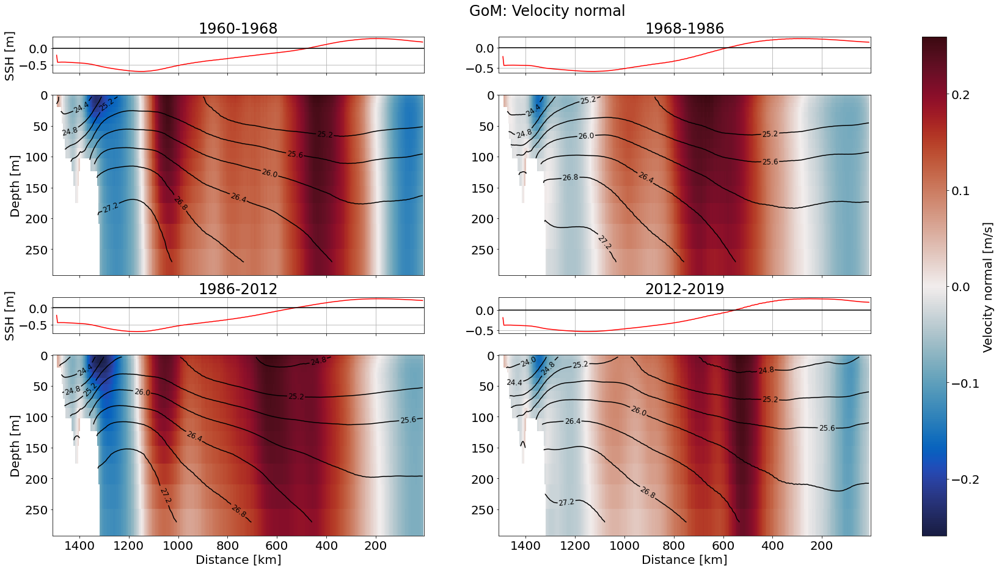

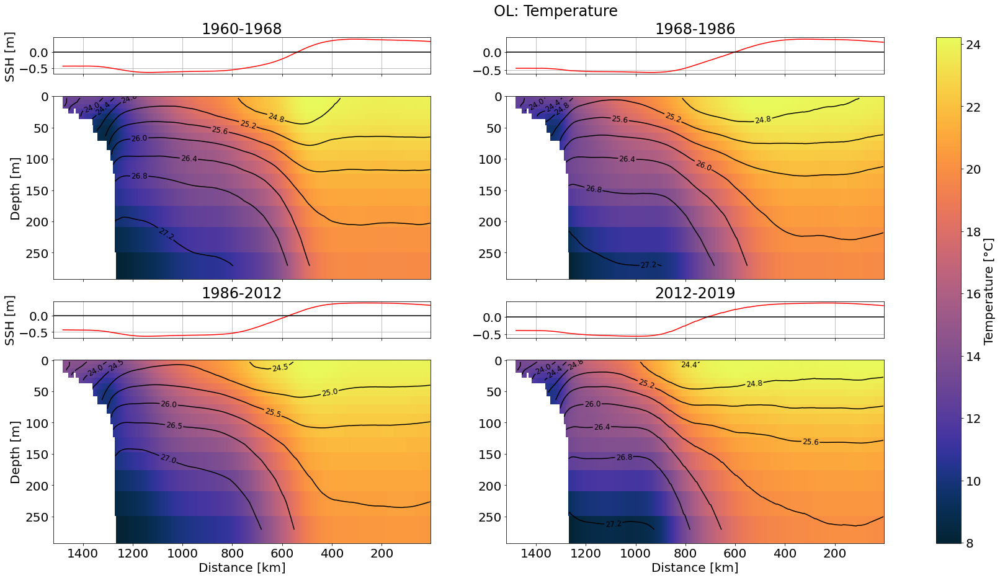

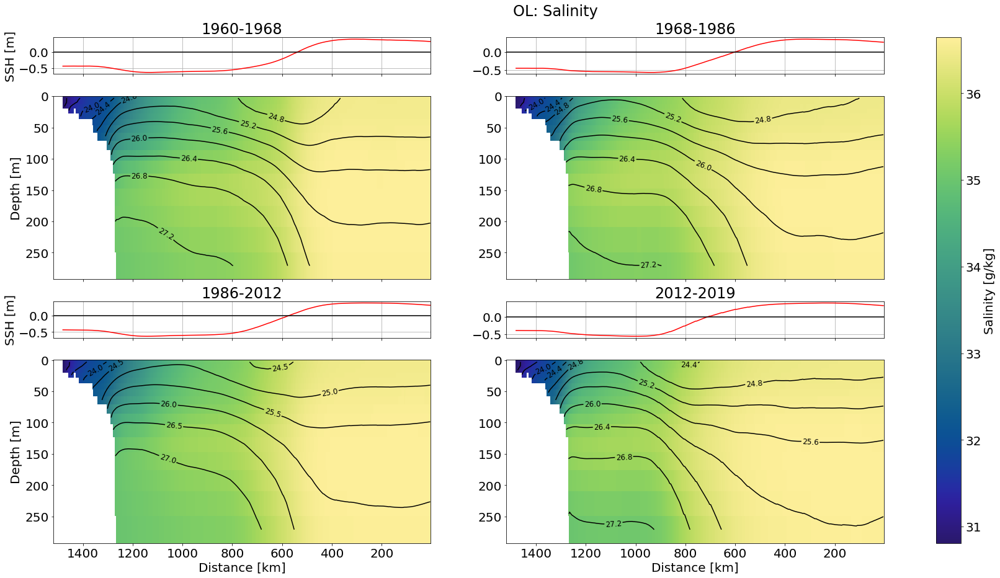

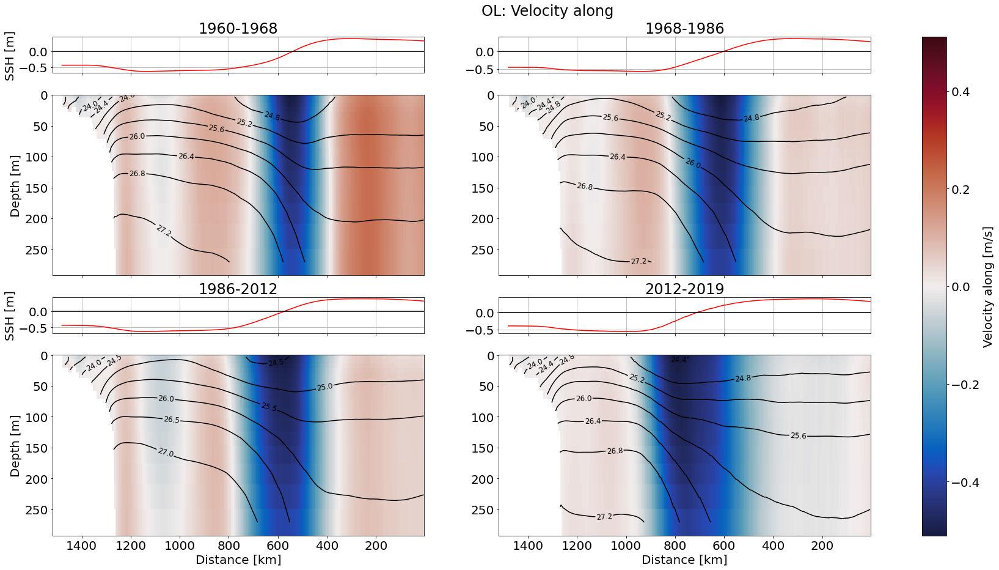

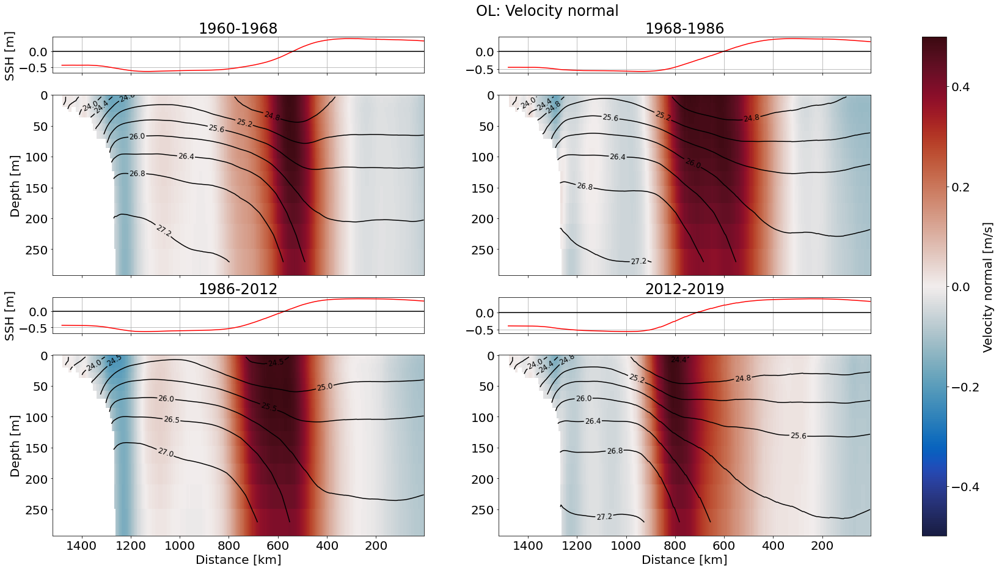

In [17]:
#Consider now time periods with composites of decadal variability
#Plot means of periods
v = [4, 1, 0.1, 0.4]
plt.rcParams['font.size'] = 20.0
cmap = [cmo.cm.thermal, cmo.cm.haline, cmo.cm.balance, cmo.cm.balance]

for i in range(len(ds)):
    for k in range(4):
        
        #Create figures
        fig, axes = plt.subplots(4, 2, figsize = (30,15), sharex = True, gridspec_kw={'height_ratios': [1, 5, 1, 5]}) 
        fig.suptitle(labels[i] + ': ' + titles[k], y = 0.93)
        
        j = 0
        p = 0
        l = 0
        axes[0][0].invert_xaxis()
        for ax in axes.flat:
            if j % 4 == 2 or j % 4 == 3:
                
                ax.invert_yaxis()                
                if cmap[k] == cmo.cm.balance: 
                    cmesh = ax.pcolormesh(ds_periods_mean[labels[i] + ':' + time_periods[l] + '-' + time_periods[l+1]].c/1e3,
                                        ds_periods_mean[labels[i] + ':' + time_periods[l] + '-' + time_periods[l+1]].z,
                                        ds_periods_mean[labels[i] + ':' + time_periods[l] + '-' + time_periods[l+1]][prop[k]],
                                        cmap = cmap[k], norm = colors.CenteredNorm())
                else:
                    cmesh = ax.pcolormesh(ds_periods_mean[labels[i] + ':' + time_periods[l] + '-' + time_periods[l+1]].c/1e3,
                                        ds_periods_mean[labels[i] + ':' + time_periods[l] + '-' + time_periods[l+1]].z,
                                        ds_periods_mean[labels[i] + ':' + time_periods[l] + '-' + time_periods[l+1]][prop[k]],
                                        cmap = cmap[k])
                    
                #Add density contour lines
                vertical_append(levels = 10, sec = ds_periods_mean[labels[i] + ':' + time_periods[l] + '-' + time_periods[l+1]],
                axh = ax)
                l += 1
    
            else: 
                ax.title.set_text(time_periods[p] + '-' + time_periods[p+1])
                ax.plot(ds_periods_mean[labels[i] + ':' + time_periods[p] + '-' + time_periods[p+1]].c/1e3,
                        ds_ssh[labels[i] + ':' + time_periods[p] + '-' + time_periods[p+1]], 
                        color = 'red')
                ax.grid()
                ax.axhline(y = 0, color = 'black')
                p += 1
            
            j += 1
            
        cbar = fig.colorbar(cmesh, ax = axes, label = titles[k] + units[k], location = 'right')
            
        #Label axes
        for ax in axes[3,:]:
            ax.set_xlabel('Distance [km]')
        for ax in axes[1::2, 0]:
            ax.set_ylabel('Depth [m]')   
        for ax in axes[::2, 0]:
            ax.set_ylabel('SSH [m]')   
        
        #Save figures
        fig.savefig(path_rp + 'DV_NAshelf_NEMO/Plots/Sections/VerticalCuts/' + titles[k] + '_comp_' + labels[i] + '.png')


## Volume transport
### Entire section
Thus, net current of Gulf stream and shelf break jet 

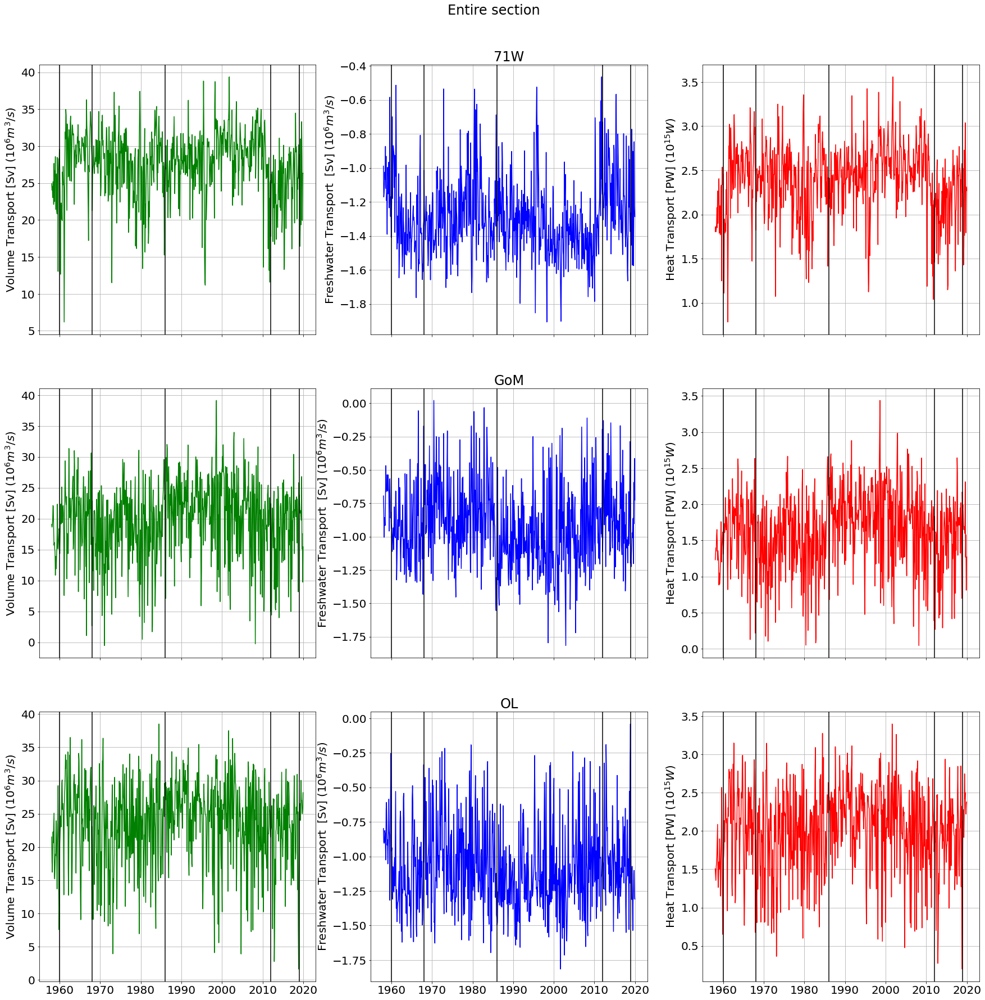

In [18]:
#Calculate volume transport
transport = []
ylabel = ['Volume Transport [Sv] ($10^6 m^3/s$)', 'Freshwater Transport  [Sv] ($10^6 m^3/s$)', 'Heat Transport [PW] ($10^{15} W$)']
tr = ['trsp', 'fw_trsp', 'ht_trsp']
color = ['g', 'b', 'r']

fig, axes = plt.subplots(3, 3, figsize = (30,30), sharex = True)
fig.suptitle('Entire section', y = 0.93)
for i in range(3):
    
    #Calculate transport 
    transport.append(bl.calculate_transport(ds[i]))
    
    for j in range(3):
        
        #Create figure
        
        if j == 2:
            axes[i][j].plot(transport[i].time_counter, transport[i][tr[j]]/1e15, color = color[j])
        else:
            axes[i][j].plot(transport[i].time_counter, transport[i][tr[j]], color = color[j])
        
        if j == 1:
            axes[i][j].title.set_text(labels[i])
        if i == 3:
            axes[i][j].set_xlabel('Years')
        axes[i][j].set_ylabel(ylabel[j])
        axes[i][j].grid()
        
        for k in range(len(time_periods)):
            axes[i][j].axvline(x = time_periods[k], color = 'black', linewidth = 1.5)
          
        
fig.savefig(path_rp + 'DV_NAshelf_NEMO/Plots/Sections/Transport/all_vo_fw_ht.png')

### Attempt to enclose SBJ and GS

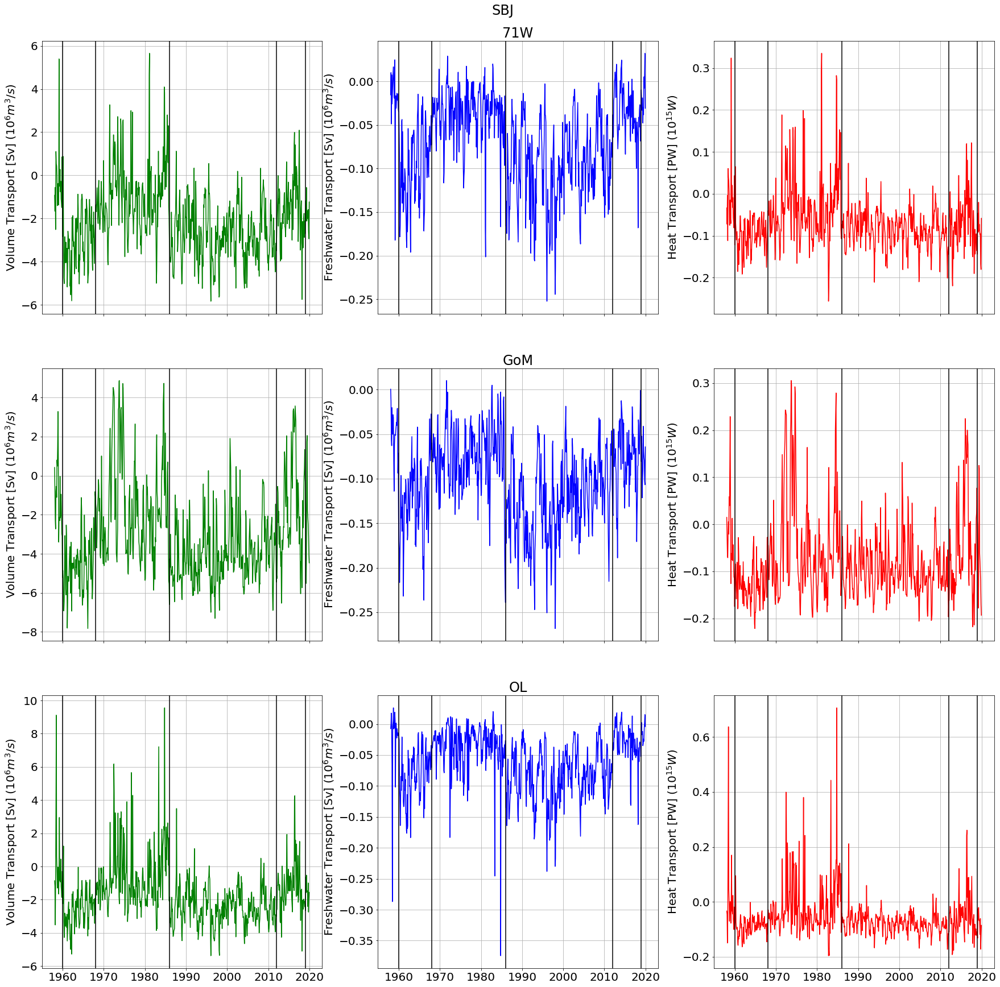

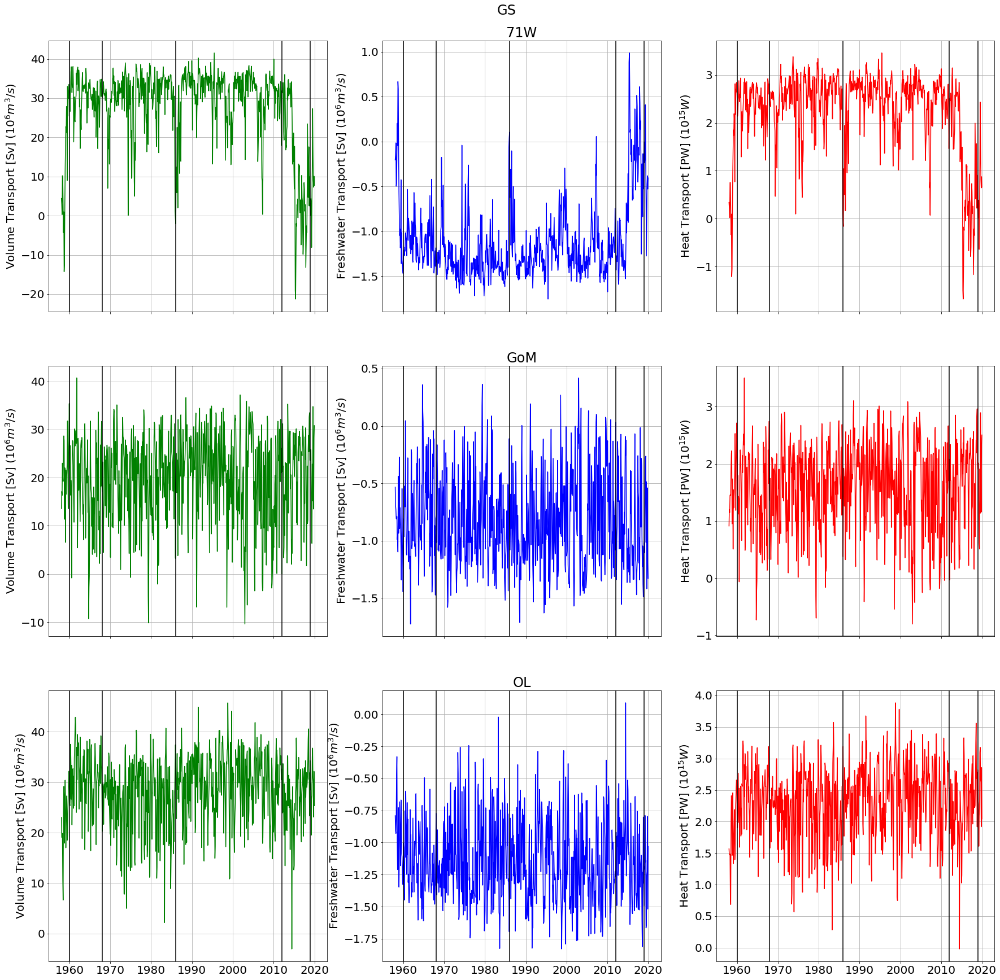

In [19]:
%matplotlib inline
plt.rcParams['font.size'] = 20.0

#Intervals 71W, GoM, OL
intervals = [[[600, 800], [1150, 1380], [1200, 1400]], [[100, 300], [330, 930], [300, 1100]]]

#Calculate volume transport

ylabel = ['Volume Transport [Sv] ($10^6 m^3/s$)', 'Freshwater Transport [Sv] ($10^6 m^3/s$)', 'Heat Transport [PW] ($10^{15} W$)']
tr = ['trsp', 'fw_trsp', 'ht_trsp']
color = ['g', 'b', 'r']

jet = ['SBJ', 'GS']
transport = []
ds_cut = []

#Loop for SBJ/GS
for p in range(2):
    fig, axes = plt.subplots(3,3, figsize = (30,30), sharex = True)
    fig.suptitle(jet[p], y = 0.91)
    #Loop for three sections
    for i in range(3):

        #Calculate transport 
        ds_cut.append(ds[i].sel(c = slice(intervals[p][i][0]*1e3, intervals[p][i][1]*1e3)))
        transport.append(bl.calculate_transport(ds_cut[i + 3*p]))

        #Loop for three transport variables
        for j in range(3):
            
            #Plot transport and in case of heat transport divide by 10^15 to obtain unit PW
            if j == 2:
                axes[i][j].plot(transport[i + 3*p].time_counter, transport[i + 3*p][tr[j]]/1e15, color = color[j])
            else:
                axes[i][j].plot(transport[i + 3*p].time_counter, transport[i + 3*p][tr[j]], color = color[j])

            if j == 1:
                axes[i][j].title.set_text(labels[i])
            if i == 3:
                axes[i][j].set_xlabel('Years')
            axes[i][j].set_ylabel(ylabel[j])
            axes[i][j].grid()
            
            #Add previously chosen time periods as vlines
            for k in range(len(time_periods)):
                axes[i][j].axvline(x = time_periods[k], color = 'black', linewidth = 1.5)


    fig.savefig(path_rp + 'DV_NAshelf_NEMO/Plots/Sections/Transport/' + jet[p] + '_vo_fw_ht.png')

### Apply low pass filter 

#### Butterworth filter

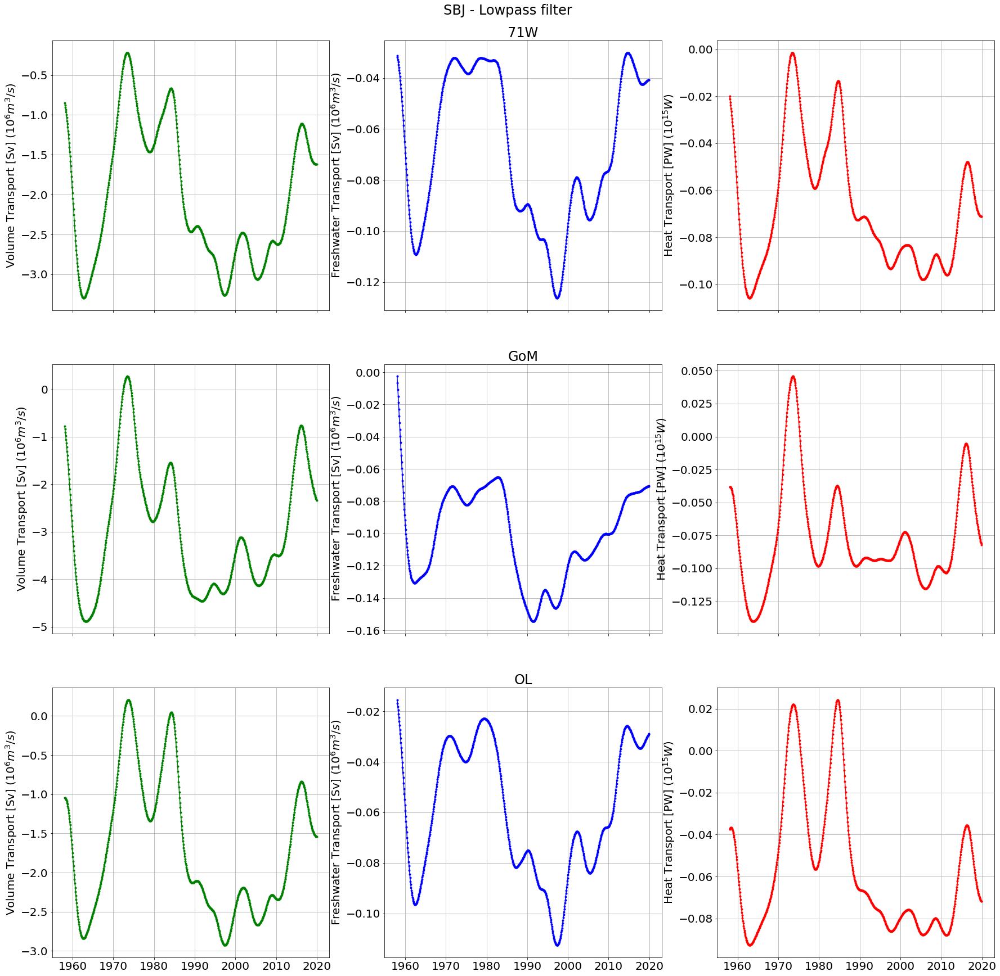

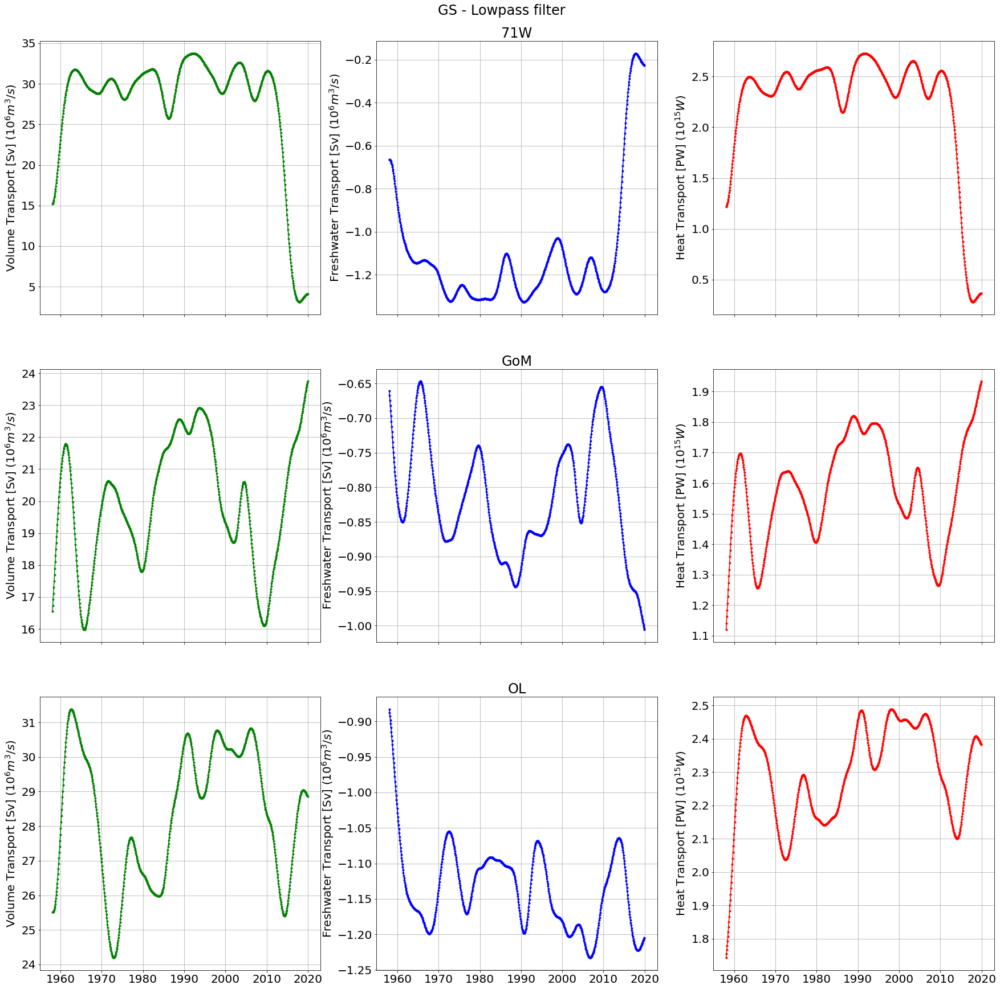

In [20]:
data_lfilt = {}
for p in range(2):
    fig, axes = plt.subplots(3,3, figsize = (30,30), sharex = True)
    fig.suptitle(jet[p] + ' - Lowpass filter', y = 0.91)
    for i in range(3):
        for j in range(3):
            data_lfilt[jet[p] + ':' + tr[j]] = butterworth_lowpass_filter(transport[i + 3*p][tr[j]], order = 2, cutoff_freq = 1/48)
            
            if j == 2:
                axes[i][j].plot(transport[i + 3*p].time_counter, data_lfilt[jet[p] + ':' + tr[j]]/1e15, color = color[j], marker = '.')
            else:
                axes[i][j].plot(transport[i + 3*p].time_counter, data_lfilt[jet[p] + ':' + tr[j]], color = color[j], marker = '.')
            
                
            if j == 1:
                axes[i][j].title.set_text(labels[i])
            if i == 3:
                axes[i][j].set_xlabel('Years')
            axes[i][j].set_ylabel(ylabel[j])
            axes[i][j].grid()
            
    fig.savefig(path_rp + 'DV_NAshelf_NEMO/Plots/Sections/Transport/' + jet[p] + '_vo_fw_ht_bworthfilter.png')

#### Running mean

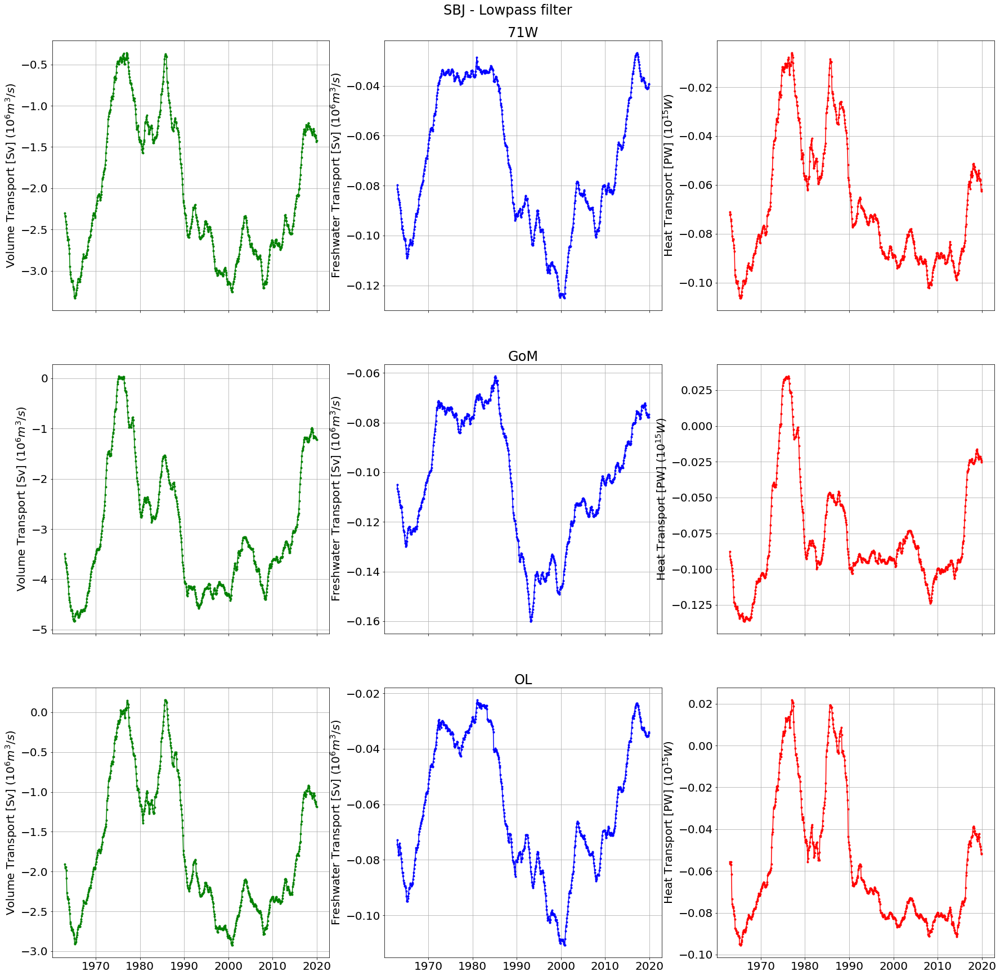

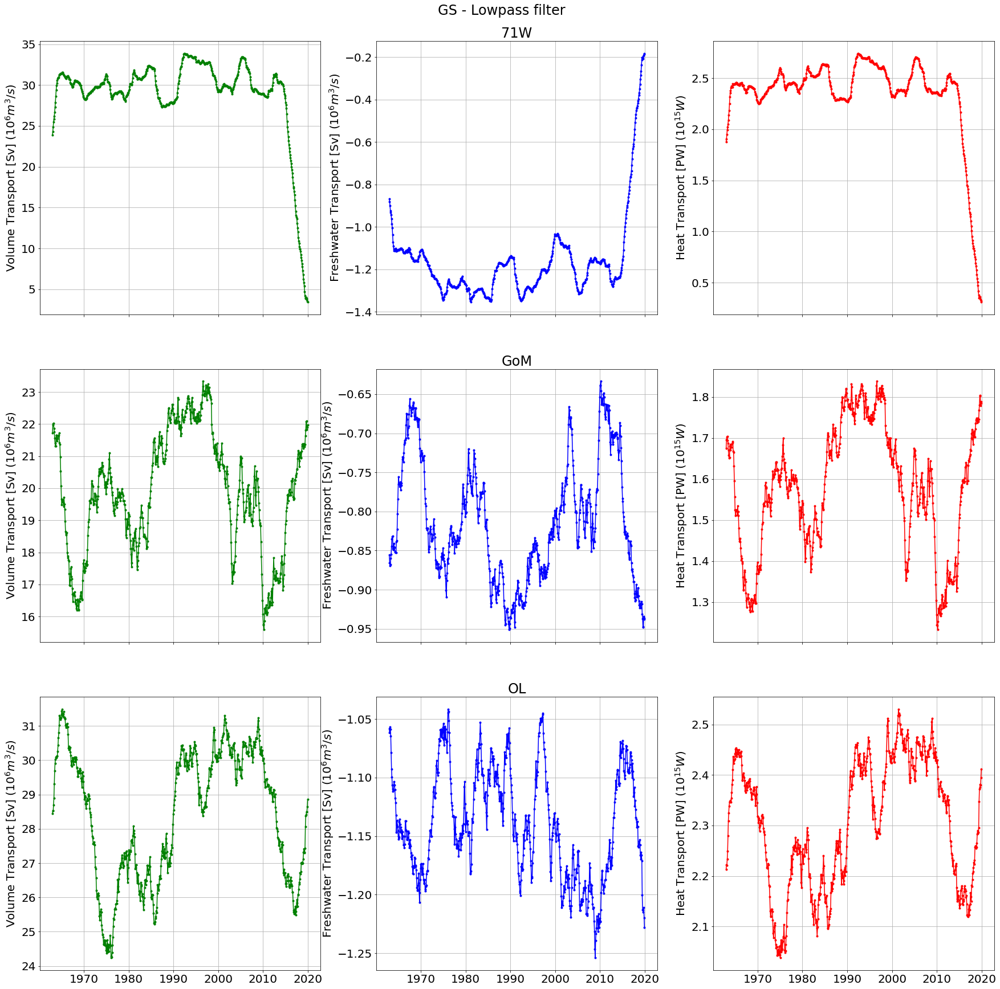

In [21]:
data_lfilt_rm = {}
for p in range(2):
    fig, axes = plt.subplots(3,3, figsize = (30,30), sharex = True)
    fig.suptitle(jet[p] + ' - Lowpass filter', y = 0.91)
    for i in range(3):
        for j in range(3):
            data_lfilt_rm[jet[p] + ':' + tr[j]] = transport[i + 3*p][tr[j]].rolling(time_counter = 60).mean(dim = 'time_counter')
            
            if j == 2:
                axes[i][j].plot(transport[i + 3*p].time_counter, data_lfilt_rm[jet[p] + ':' + tr[j]]/1e15, color = color[j], marker = '.')
            else:
                axes[i][j].plot(transport[i + 3*p].time_counter, data_lfilt_rm[jet[p] + ':' + tr[j]], color = color[j], marker = '.')
            
            if j == 1:
                axes[i][j].title.set_text(labels[i])
            if i == 3:
                axes[i][j].set_xlabel('Years')
            axes[i][j].set_ylabel(ylabel[j])
            axes[i][j].grid()
            
    fig.savefig(path_rp + 'DV_NAshelf_NEMO/Plots/Sections/Transport/' + jet[p] + '_vo_fw_ht_runmeanfilter.png')      

## SSS along 71W
For comparison to SSS from observations

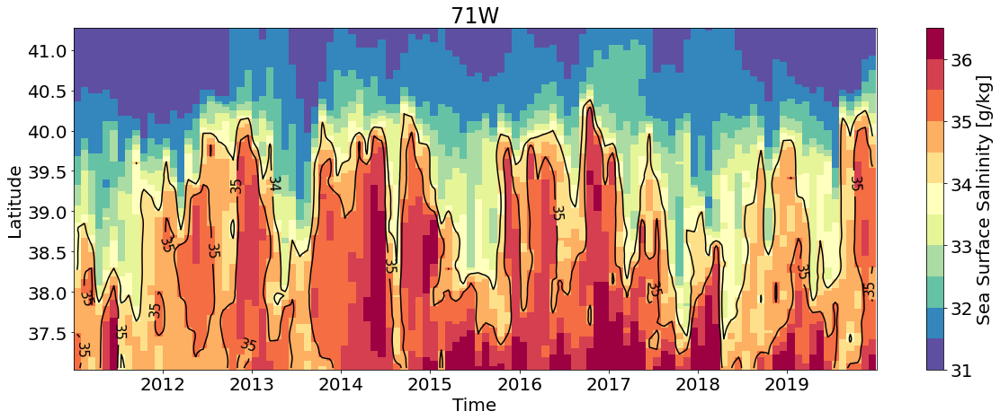

In [22]:
#Verifying interannual variability of SSS along 71W

time_int = slice('16-01-2011', '16-12-2019')

ds_71W_cut = ds_71W.sel(time_counter = time_int, c = ds_71W.c[80:200], z = ds_71W.z[0])
fig, ax = plt.subplots(1,1, figsize = (20,7))

cmap = plt.colormaps['Spectral'].reversed()# cmo.cm.haline
levels = MaxNLocator(nbins=11).tick_values(31.0, 36.5)
#levels = MaxNLocator(nbins=15).tick_values(ds_surf[i]['vosaline'].min(), ds_surf[i]['vosaline'].max())
norm = BoundaryNorm(levels, ncolors=cmap.N, clip=True)

lat, time = np.meshgrid(ds_71W_cut.lat, ds_71W_cut.time_counter)
cmesh = ax.pcolormesh(time, lat, ds_71W_cut['vosaline'], cmap = cmap, norm = norm)
cbar = fig.colorbar(cmesh, label = 'Sea Surface Salninity [g/kg]', location = 'right')
#cbar.ax.invert_yaxis()
#Add contour lines
cont = ax.contour(time, lat, ds_71W_cut['vosaline'], levels = [34, 35], colors = ['black', 'black'])
ax.clabel(cont, fontsize = 15)

ax.set_xlabel('Time')
ax.set_ylabel('Latitude')

ax.title.set_text('71W')

fig.savefig(path_rp + 'DV_NAshelf_NEMO/Plots/Sections/SSS_71W.png')

## Shelf break jet analysis - For more sophisticated analysis for the Oleander line check file "Oleander.ipynb"
### Gulf of Maine
To begin with, the time mean velocity field is plotted to get a feeling for the width of the shelfbreakjet

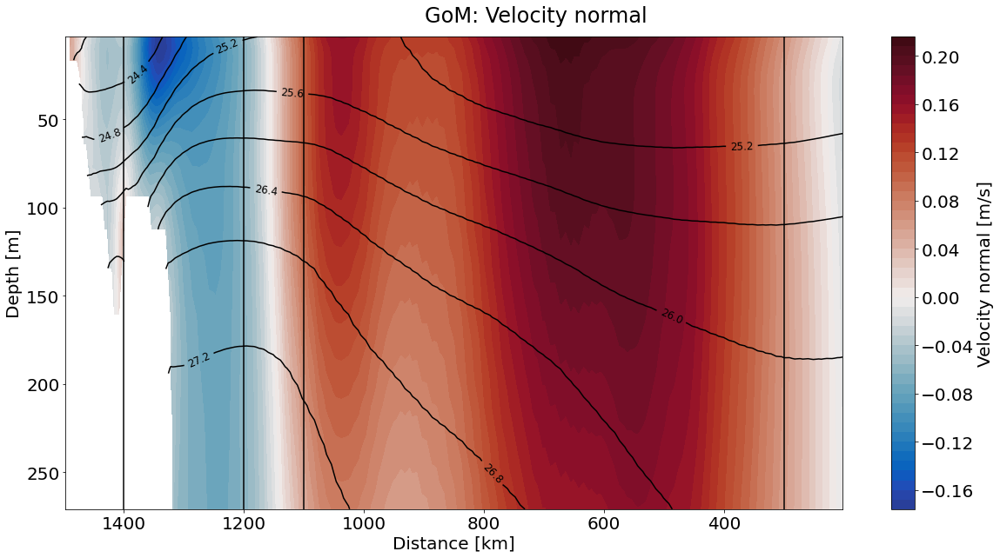

In [23]:
%matplotlib inline
plt.rcParams['font.size'] = 20.0
#Characterize position of shelf break jet and cut data where velocity is zero (round about)
ds_GoM_sbj_mean = ds_GoM.sel(c = slice(200*1e3, 1500*1e3)).mean(dim = 'time_counter')

#Take time-mean and plot T,S, u and v 
#Create subplots
fig, ax = plt.subplots(figsize = (20,10))
fig.suptitle('GoM: Velocity normal', y = 0.93)
cmap = 'cmo.balance'

#Create colormesh and make sure velocity colorbars are normalized
cmesh = ax.contourf(ds_GoM_sbj_mean.c/1e3, ds_GoM_sbj_mean.z, ds_GoM_sbj_mean['u_rot_normal'], cmap = cmap, levels = 50, norm = colors.CenteredNorm())

fig.colorbar(cmesh, ax = ax, label = 'Velocity normal [m/s]', location = 'right')

#Add density contour lines
vertical_append(levels = 10, sec = ds_GoM_sbj_mean, axh = ax)

#Invert axes
ax.invert_yaxis()
ax.invert_xaxis()

ax.set_xlabel('Distance [km]')
ax.set_ylabel('Depth [m]')
      
#Plot vertical lines for chosen intervals
ax.axvline(x = intervals[0][2][0], color = 'black')
ax.axvline(x = intervals[0][2][1], color = 'black')
ax.axvline(x = intervals[1][2][0], color = 'black')
ax.axvline(x = intervals[1][2][1], color = 'black')

fig.savefig(path_rp + 'DV_NAshelf_NEMO/Plots/Sections/SBJ/GoM/time_mean.png')

## Monthly Data
### Animation of monthly data (underlies greater variation)

### Snapshot
Tool for plotting a snapshot with identified SBJ maximum

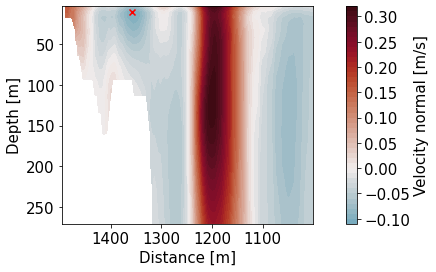

In [24]:
%matplotlib inline
plt.rcParams['font.size'] = 15.0
#For algorithm cut off data with depth
ds_GoM_sbj = ds_GoM.sel(c = slice(1000*1e3, 1500*1e3))
ds_GoM_sbj_cut = ds_GoM_sbj.sel(z = slice(0, 50))

#Find position of sbj of a given time frame
# 1986-04 1994-03 1967-06 1969-01 1973-03 1975-07
time_frame = '16-07-1973'
sbj_pos = np.where(ds_GoM_sbj_cut.sel(time_counter = time_frame)['u_rot_normal'][0] == ds_GoM_sbj_cut.sel(time_counter = time_frame)['u_rot_normal'][0].min() )

#Add initial colormesh
fig, ax = plt.subplots()
cmesh = ax.contourf(ds_GoM_sbj.c/1e3, ds_GoM_sbj.z, ds_GoM_sbj.sel(time_counter = time_frame)['u_rot_normal'][0], 
                    cmap = cmap, levels = 50, norm = colors.CenteredNorm())
ax.invert_xaxis()
ax.invert_yaxis()
ax.set_xlabel('Distance [m]')
ax.set_ylabel('Depth [m]')

cbar = fig.colorbar(cmesh, ax = ax, location = 'right', label = 'Velocity normal [m/s]', pad = 0.1)
ax.scatter(ds_GoM_sbj_cut.c[sbj_pos[1]]/1e3, ds_GoM_sbj_cut.z[sbj_pos[0]], color = 'red', marker = 'x')

fig.savefig(path_rp + 'DV_NAshelf_NEMO/Plots/Sections/SBJ/GoM/snapshot_' + time_frame + '.png')


### Animation of SBJ maximum determination

<IPython.core.display.Javascript object>


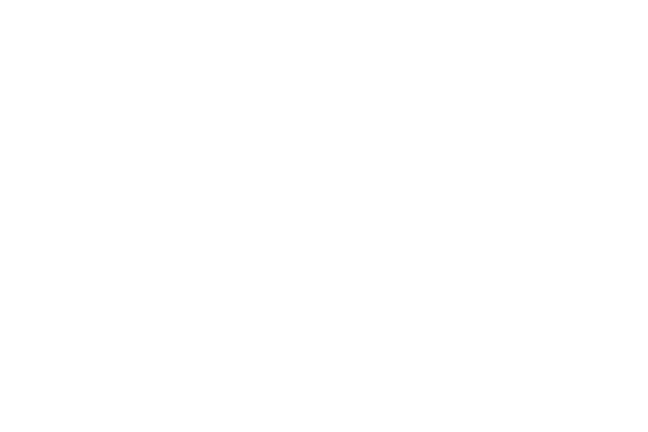

In [25]:
%matplotlib notebook
plt.rcParams['font.size'] = 15.0
ds_GoM_sbj = ds_GoM.sel(c = slice(1000*1e3, 1500*1e3))
ds_GoM_sbj_cut = ds_GoM_sbj.sel(z = slice(0, 50), c = slice(1200*1e3, 1400*1e3))

#Create animation of position of SBJ

#Creating figures
fig, ax = plt.subplots()

#Define observation period
time_begin = '16-01-1958'
time_end = '16-12-2019'

#Select data from time period
ds_GoM_sbj = ds_GoM_sbj.sel(time_counter = slice(time_begin, time_end))
ds_GoM_sbj_cut = ds_GoM_sbj_cut.sel(time_counter = slice(time_begin, time_end))

#Add initial colormesh
cmesh = ax.contourf(ds_GoM_sbj.c/1e3, ds_GoM_sbj.z, ds_GoM_sbj['u_rot_normal'][0], 
                    cmap = cmap, levels = 50, norm = colors.CenteredNorm())
cbar = fig.colorbar(cmesh, ax = ax, location = 'right', label = 'Velocity normal [m/s]', pad = 0.1)

sbj_pos = np.where(ds_GoM_sbj_cut['u_rot_normal'][0] == ds_GoM_sbj_cut['u_rot_normal'][0].min())
sctt = ax.scatter(ds_GoM_sbj_cut.c[sbj_pos[1]]/1e3, ds_GoM_sbj_cut.z[sbj_pos[0]], color = 'red', marker = 'x')

def animate(i):
    
   
    ax.clear()
    cmesh = ax.contourf(ds_GoM_sbj.c/1e3, ds_GoM_sbj.z, ds_GoM_sbj['u_rot_normal'][i], 
                    cmap = cmap, levels = 50, norm = colors.CenteredNorm())
    
    sbj_pos = np.where(ds_GoM_sbj_cut['u_rot_normal'][i] == ds_GoM_sbj_cut['u_rot_normal'][i].min())
    ax.scatter(ds_GoM_sbj_cut.c[sbj_pos[1]]/1e3, ds_GoM_sbj_cut.z[sbj_pos[0]], color = 'red', marker = 'x')
    ax.invert_xaxis()
    ax.invert_yaxis()
    ax.set_title('GoM: ' + np.datetime_as_string(ds_GoM_sbj['time_counter'][i].to_numpy(), unit = 'M'))


anim = FuncAnimation(fig, animate, frames = len(ds_GoM_sbj.time_counter.to_numpy()), interval = 1000, blit = False)
anim.save(path_rp + 'DV_NAshelf_NEMO/Plots/Sections/SBJ/GoM/sbj_position.gif', writer='imagemagick', fps=1)

### Histogram of SBJ position

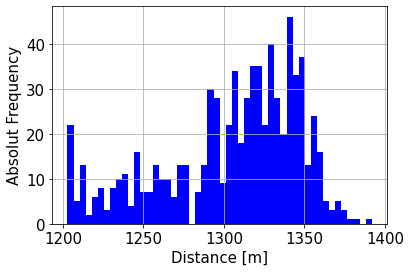

In [26]:
%matplotlib inline
plt.rcParams['font.size'] = 15.0
#Create figure
fig, ax = plt.subplots()

#Save positions of SBJ
sbj_ind = []
sbj_pos = []
for i in range(len(ds_GoM_sbj.time_counter.to_numpy())):
    sbj_ind.append(np.where(ds_GoM_sbj_cut['u_rot_normal'][i] == ds_GoM_sbj_cut['u_rot_normal'][i].min())[1])
    sbj_pos.append(ds_GoM_sbj_cut.c[sbj_ind[i]].to_numpy()[0]/1e3)

# sbj_pos
ax.hist(sbj_pos, bins = 50, color = 'blue')
ax.grid()
ax.set_xlabel('Distance [m]')
ax.set_ylabel('Absolut Frequency')

#Save figure
fig.savefig(path_rp + 'DV_NAshelf_NEMO/Plots/Sections/SBJ/GoM/hist_sbj_pos.png')

## Average for each year
Reduce data via yearly mean to 'stabilize' determination of SBJ

<IPython.core.display.Javascript object>


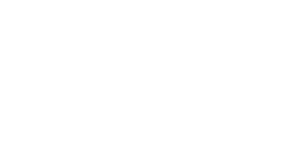

In [27]:
%matplotlib notebook
plt.rcParams['font.size'] = 15.0
ds_GoM_sbj_gr = ds_GoM_sbj.groupby('time_counter.year').mean(dim = 'time_counter')

ds_GoM_sbj_gr_cut = ds_GoM_sbj_gr.sel(z = slice(0, 50), c = slice(1250*1e3, 1400*1e3))

#Create animation of position of SBJ

#Creating figures
fig, ax = plt.subplots()

#Define observation period
time_begin = '1958'
time_end = '2019'

#Select data from time period
ds_GoM_sbj_gr = ds_GoM_sbj_gr.sel(year = slice(time_begin, time_end))
ds_GoM_sbj_gr_cut = ds_GoM_sbj_gr_cut.sel(year = slice(time_begin, time_end))

#Add initial colormesh
cmesh = ax.contourf(ds_GoM_sbj_gr.c/1e3, ds_GoM_sbj_gr.z, ds_GoM_sbj_gr['u_rot_normal'][0], 
                    cmap = cmap, levels = 50, norm = colors.CenteredNorm())
cbar = fig.colorbar(cmesh, ax = ax, location = 'right', label = 'Velocity normal [m/s]', pad = 0.1)

sbj_pos = np.where(ds_GoM_sbj_gr_cut['u_rot_normal'][0] == ds_GoM_sbj_gr_cut['u_rot_normal'][0].min())
sctt = ax.scatter(ds_GoM_sbj_gr_cut.c[sbj_pos[1]]/1e3, ds_GoM_sbj_gr_cut.z[sbj_pos[0]], color = 'red', marker = 'x')
ax.invert_xaxis()
ax.invert_yaxis()


def animate(i):
    
    ax.clear()
    cmesh = ax.contourf(ds_GoM_sbj_gr.c/1e3, ds_GoM_sbj_gr.z, ds_GoM_sbj_gr['u_rot_normal'][i], 
                    cmap = cmap, levels = 50, norm = colors.CenteredNorm())
    
    sbj_pos = np.where(ds_GoM_sbj_gr_cut['u_rot_normal'][i] == ds_GoM_sbj_gr_cut['u_rot_normal'][i].min())
    ax.scatter(ds_GoM_sbj_gr_cut.c[sbj_pos[1]]/1e3, ds_GoM_sbj_gr_cut.z[sbj_pos[0]], color = 'red', marker = 'x')
    ax.invert_xaxis()
    ax.invert_yaxis()
    ax.set_title('GoM: ' + '{}'.format(ds_GoM_sbj_gr['year'][i].to_numpy()))
    ax.set_xlabel('Distance [m]')
    ax.set_ylabel('Depth [m]')

anim = FuncAnimation(fig, animate, frames = len(ds_GoM_sbj_gr.year.to_numpy()), interval = 1000, blit = False)
anim.save(path_rp + 'DV_NAshelf_NEMO/Plots/Sections/SBJ/GoM/sbj_position_yearly.gif', writer='imagemagick', fps=1)


### Histogram of SBJ position - Yearly

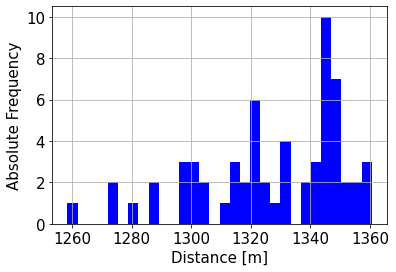

In [28]:
%matplotlib inline
plt.rcParams['font.size'] = 15.0
#Save positions of SBJ
sbj_ind = []
sbj_pos = []
for i in range(len(ds_GoM_sbj_gr.year.to_numpy())):
    sbj_ind.append(np.where(ds_GoM_sbj_gr_cut['u_rot_normal'][i] == ds_GoM_sbj_gr_cut['u_rot_normal'][i].min())[1])
    sbj_pos.append(ds_GoM_sbj_gr_cut.c[sbj_ind[i]].to_numpy()[0]/1e3)

# sbj_pos
fig, ax = plt.subplots()
ax.hist(sbj_pos, bins = 30, color = 'blue')
ax.grid()
ax.set_xlabel('Distance [m]')
ax.set_ylabel('Absolute Frequency')

#Save figure
fig.savefig(path_rp + 'DV_NAshelf_NEMO/Plots/Sections/SBJ/GoM/hist_sbj_pos_yearly.png')

### Oleander Line

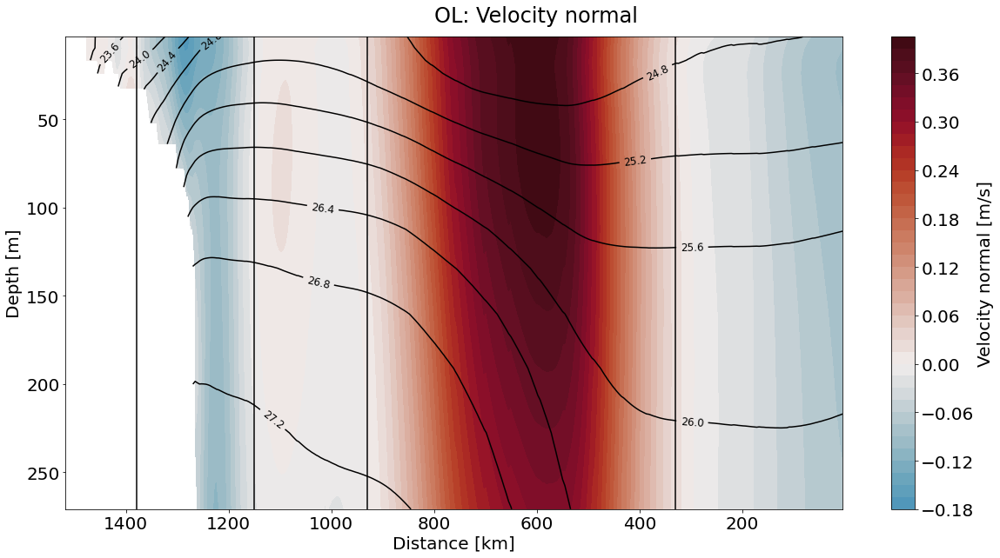

In [29]:
%matplotlib inline
plt.rcParams['font.size'] = 20.0

#Characterize position of shelf break jet and cut data where velocity is zero (round about)
ds_OL_sbj_mean = ds_OL.mean(dim = 'time_counter')

#Take time-mean and plot T,S, u and v 
#Create subplots
fig, ax = plt.subplots(figsize = (20,10))
fig.suptitle('OL: Velocity normal', y = 0.93)
cmap = 'cmo.balance'

#Create colormesh and make sure velocity colorbars are normalized
cmesh = ax.contourf(ds_OL_sbj_mean.c/1e3, ds_OL_sbj_mean.z, ds_OL_sbj_mean['u_rot_normal'], cmap = cmap, levels = 50, norm = colors.CenteredNorm())

fig.colorbar(cmesh, ax = ax, label = 'Velocity normal [m/s]', location = 'right')

#Add density contour lines
vertical_append(levels = 10, sec = ds_OL_sbj_mean, axh = ax)

#Invert axes
ax.invert_yaxis()
ax.invert_xaxis()

ax.set_xlabel('Distance [km]')
ax.set_ylabel('Depth [m]')

#Plot vertical lines for chosen intervals
ax.axvline(x = intervals[0][1][0], color = 'black')
ax.axvline(x = intervals[0][1][1], color = 'black')
ax.axvline(x = intervals[1][1][0], color = 'black')
ax.axvline(x = intervals[1][1][1], color = 'black')



#Save figure
fig.savefig(path_rp + 'DV_NAshelf_NEMO/Plots/Sections/SBJ/Oleander/time_mean.png')

## Monthly Data
### Animation of monthly data (underlies greater variation)

<IPython.core.display.Javascript object>


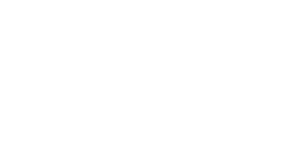

In [30]:
%matplotlib notebook
plt.rcParams['font.size'] = 15.0
ds_OL_sbj = ds_OL.sel(c = slice(1000*1e3, 1500*1e3))
ds_OL_sbj_cut = ds_OL_sbj.sel(z = slice(0, 100), c = slice(1000*1e3, 1500*1e3))

#Create animation of position of SBJ

#Creating figures
fig, ax = plt.subplots()

#Define observation period
time_begin = '16-01-1958'
time_end = '16-12-2019'

#Select data from time period
ds_OL_sbj = ds_OL_sbj.sel(time_counter = slice(time_begin, time_end))
ds_OL_sbj_cut = ds_OL_sbj_cut.sel(time_counter = slice(time_begin, time_end))

#Add initial colormesh
cmesh = ax.contourf(ds_OL_sbj.c/1e3, ds_OL_sbj.z, ds_OL_sbj['u_rot_normal'][0], 
                    cmap = cmap, levels = 50, norm = colors.CenteredNorm())
cbar = fig.colorbar(cmesh, ax = ax, location = 'right', label = 'Velocity normal [m/s]', pad = 0.1)
ax.set_xlabel('Distance [m]')
ax.set_ylabel('Depth [m]')
sbj_pos = np.where(ds_OL_sbj_cut['u_rot_normal'][0] == ds_OL_sbj_cut['u_rot_normal'][0].min())
sctt = ax.scatter(ds_OL_sbj_cut.c[sbj_pos[1]]/1e3, ds_OL_sbj_cut.z[sbj_pos[0]], color = 'red', marker = 'x')

def animate(i):
    
   
    ax.clear()
    cmesh = ax.contourf(ds_OL_sbj.c/1e3, ds_OL_sbj.z, ds_OL_sbj['u_rot_normal'][i], 
                    cmap = cmap, levels = 50, norm = colors.CenteredNorm())
    
    sbj_pos = np.where(ds_OL_sbj_cut['u_rot_normal'][i] == ds_OL_sbj_cut['u_rot_normal'][i].min())
    ax.scatter(ds_OL_sbj_cut.c[sbj_pos[1]]/1e3, ds_OL_sbj_cut.z[sbj_pos[0]], color = 'red', marker = 'x')
    ax.invert_xaxis()
    ax.invert_yaxis()
    ax.set_title('OL: ' + np.datetime_as_string(ds_OL_sbj['time_counter'][i].to_numpy(), unit = 'M'))
    ax.set_xlabel('Distance [m]')
    ax.set_ylabel('Depth [m]')

anim = FuncAnimation(fig, animate, frames = len(ds_OL_sbj.time_counter.to_numpy()), interval = 1000, blit = False)
anim.save(path_rp + 'DV_NAshelf_NEMO/Plots/Sections/SBJ/Oleander/sbj_position.gif', writer='imagemagick', fps=1)

### Histogram of SBJ position

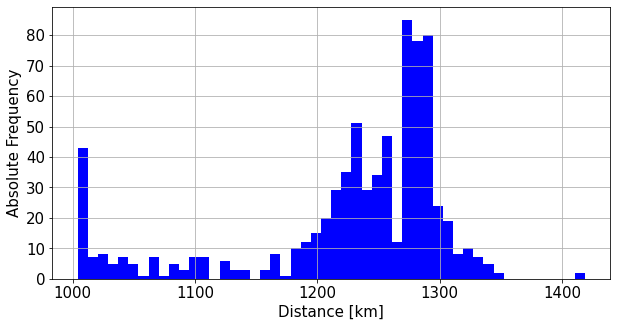

In [31]:
%matplotlib inline
plt.rcParams['font.size'] = 15.0
#Save positions of SBJ
fig, ax = plt.subplots(figsize = (10,5))
sbj_ind = []
sbj_pos = []
for i in range(len(ds_OL_sbj.time_counter.to_numpy())):
    sbj_ind.append(np.where(ds_OL_sbj_cut['u_rot_normal'][i] == ds_OL_sbj_cut['u_rot_normal'][i].min())[1])
    sbj_pos.append(ds_OL_sbj_cut.c[sbj_ind[i]].to_numpy()[0]/1e3)

# sbj_pos
ax.hist(sbj_pos, bins = 50, color = 'blue')
ax.grid()
ax.set_xlabel('Distance [km]')
ax.set_ylabel('Absolute Frequency')

#Save figure
fig.savefig(path_rp + 'DV_NAshelf_NEMO/Plots/Sections/SBJ/Oleander/hist_sbj_pos.png')

## Average for each year
Reduce data via yearly mean to 'stabilize' determination of SBJ

<IPython.core.display.Javascript object>


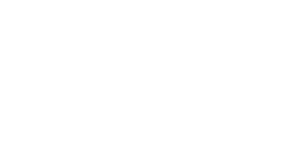

In [32]:
%matplotlib notebook
plt.rcParams['font.size'] = 15.0
ds_OL_sbj_gr = ds_OL_sbj.groupby('time_counter.year').mean(dim = 'time_counter')

ds_OL_sbj_gr_cut = ds_OL_sbj_gr.sel(z = slice(0, 50), c = slice(1200*1e3, 1500*1e3))

#Create animation of position of SBJ

#Creating figures
fig, ax = plt.subplots()

#Define observation period
time_begin = '1958'
time_end = '2019'

#Select data from time period
ds_OL_sbj_gr = ds_OL_sbj_gr.sel(year = slice(time_begin, time_end))
ds_OL_sbj_gr_cut = ds_OL_sbj_gr_cut.sel(year = slice(time_begin, time_end))

#Add initial colormesh
cmesh = ax.contourf(ds_OL_sbj_gr.c/1e3, ds_OL_sbj_gr.z, ds_OL_sbj_gr['u_rot_normal'][0], 
                    cmap = cmap, levels = 50, norm = colors.CenteredNorm())
cbar = fig.colorbar(cmesh, ax = ax, location = 'right', label = 'Velocity normal [m/s]', pad = 0.1)

sbj_pos = np.where(ds_OL_sbj_gr_cut['u_rot_normal'][0] == ds_OL_sbj_gr_cut['u_rot_normal'][0].min())
sctt = ax.scatter(ds_OL_sbj_gr_cut.c[sbj_pos[1]]/1e3, ds_OL_sbj_gr_cut.z[sbj_pos[0]], color = 'red', marker = 'x')
ax.invert_xaxis()
ax.invert_yaxis()


def animate(i):
    
    ax.clear()
    cmesh = ax.contourf(ds_OL_sbj_gr.c/1e3, ds_OL_sbj_gr.z, ds_OL_sbj_gr['u_rot_normal'][i], 
                    cmap = cmap, levels = 50, norm = colors.CenteredNorm())
    
    sbj_pos = np.where(ds_OL_sbj_gr_cut['u_rot_normal'][i] == ds_OL_sbj_gr_cut['u_rot_normal'][i].min())
    ax.scatter(ds_OL_sbj_gr_cut.c[sbj_pos[1]]/1e3, ds_OL_sbj_gr_cut.z[sbj_pos[0]], color = 'red', marker = 'x')
    ax.invert_xaxis()
    ax.invert_yaxis()
    ax.set_title('OL: ' + '{}'.format(ds_OL_sbj_gr['year'][i].to_numpy()))
    ax.set_xlabel('Distance [m]')
    ax.set_ylabel('Depth [m]')

anim = FuncAnimation(fig, animate, frames = len(ds_OL_sbj_gr.year.to_numpy()), interval = 1000, blit = False)
anim.save(path_rp + 'DV_NAshelf_NEMO/Plots/Sections/SBJ/Oleander/sbj_position_yearly.gif', writer='imagemagick', fps=1)


### Histogram of SBJ position - Yearly

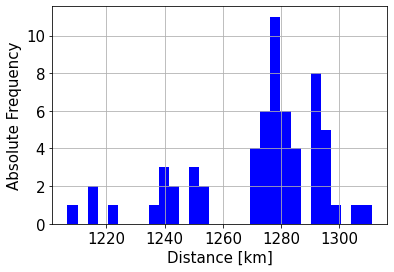

In [33]:
%matplotlib inline
plt.rcParams['font.size'] = 15.0
#Save positions of SBJ
sbj_ind = []
sbj_pos = []
for i in range(len(ds_OL_sbj_gr.year.to_numpy())):
    sbj_ind.append(np.where(ds_OL_sbj_gr_cut['u_rot_normal'][i] == ds_OL_sbj_gr_cut['u_rot_normal'][i].min())[1])
    sbj_pos.append(ds_OL_sbj_gr_cut.c[sbj_ind[i]].to_numpy()[0]/1e3)

# sbj_pos
fig, ax = plt.subplots()
ax.hist(sbj_pos, bins = 30, color = 'blue')
ax.grid()
ax.set_xlabel('Distance [km]')
ax.set_ylabel('Absolute Frequency')

#Save figure
fig.savefig(path_rp + 'DV_NAshelf_NEMO/Plots/Sections/SBJ/Oleander/hist_sbj_pos_yearly.png')

### 71W

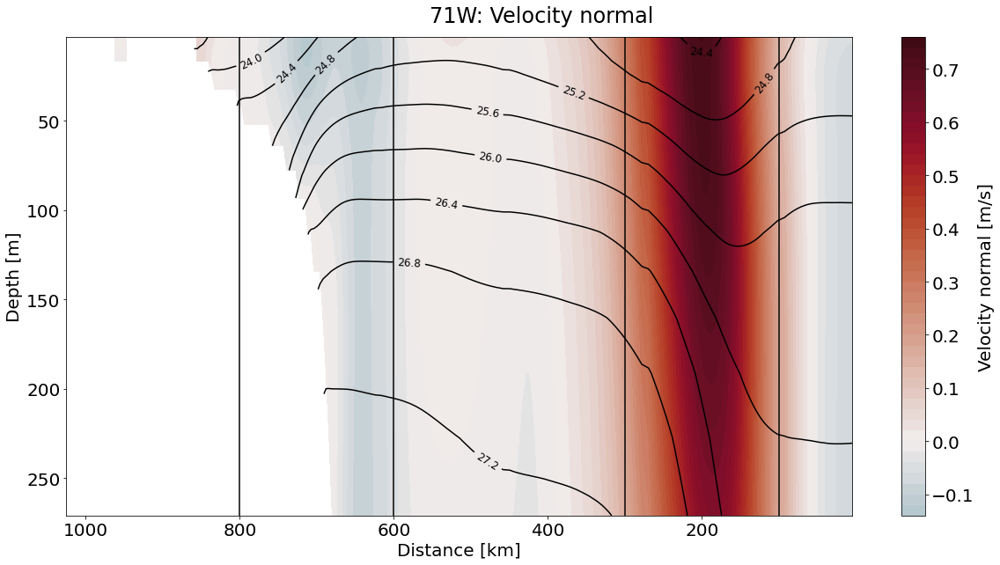

In [34]:
%matplotlib inline
plt.rcParams['font.size'] = 20.0
#Characterize position of shelf break jet and cut data where velocity is zero (round about)
ds_71W_sbj_mean = ds_71W.mean(dim = 'time_counter')

#Take time-mean and plot T,S, u and v 
#Create subplots
fig, ax = plt.subplots(figsize = (20,10))
fig.suptitle('71W: Velocity normal', y = 0.93)
cmap = 'cmo.balance'

#Create colormesh and make sure velocity colorbars are normalized
cmesh = ax.contourf(ds_71W_sbj_mean.c/1e3, ds_71W_sbj_mean.z, ds_71W_sbj_mean['u_rot_normal'], cmap = cmap, levels = 50, norm = colors.CenteredNorm())

fig.colorbar(cmesh, ax = ax, label = 'Velocity normal [m/s]', location = 'right')

#Add density contour lines
vertical_append(levels = 10, sec = ds_71W_sbj_mean, axh = ax)

#Invert axes
ax.invert_yaxis()
ax.invert_xaxis()

ax.set_xlabel('Distance [km]')
ax.set_ylabel('Depth [m]')

#Plot vertical lines for chosen intervals
ax.axvline(x = intervals[0][0][0], color = 'black')
ax.axvline(x = intervals[0][0][1], color = 'black')
ax.axvline(x = intervals[1][0][0], color = 'black')
ax.axvline(x = intervals[1][0][1], color = 'black')

#Save figure
fig.savefig(path_rp + 'DV_NAshelf_NEMO/Plots/Sections/SBJ/71W/time_mean.png')
    

## Monthly Data
### Animation of monthly data (underlies greater variation)

<IPython.core.display.Javascript object>


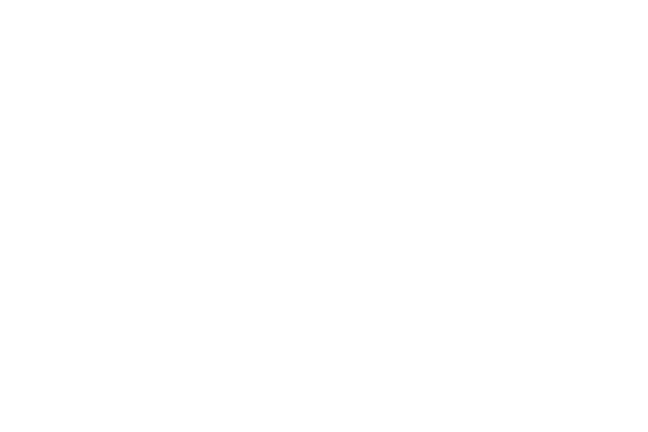

In [35]:
%matplotlib notebook
plt.rcParams['font.size'] = 15.0
ds_71W_sbj = ds_71W.sel(c = slice(100*1e3, 1000*1e3))
ds_71W_sbj_cut = ds_71W_sbj.sel(z = slice(0, 100), c = slice(600*1e3, 800*1e3))

#Create animation of position of SBJ

#Creating figures
fig, ax = plt.subplots()

#Define observation period
time_begin = '16-01-1958'
time_end = '16-12-2019'

#Select data from time period
ds_71W_sbj = ds_71W_sbj.sel(time_counter = slice(time_begin, time_end))
ds_71W_sbj_cut = ds_71W_sbj_cut.sel(time_counter = slice(time_begin, time_end))

#Add initial colormesh
cmesh = ax.contourf(ds_71W_sbj.c/1e3, ds_71W_sbj.z, ds_71W_sbj['u_rot_normal'][0], 
                    cmap = cmap, levels = 50, norm = colors.CenteredNorm())
cbar = fig.colorbar(cmesh, ax = ax, location = 'right', label = 'Velocity normal [m/s]', pad = 0.1)

sbj_pos = np.where(ds_71W_sbj_cut['u_rot_normal'][0] == ds_71W_sbj_cut['u_rot_normal'][0].min())
sctt = ax.scatter(ds_71W_sbj_cut.c[sbj_pos[1]]/1e3, ds_71W_sbj_cut.z[sbj_pos[0]], color = 'red', marker = 'x')

def animate(i):
    
   
    ax.clear()
    cmesh = ax.contourf(ds_71W_sbj.c/1e3, ds_71W_sbj.z, ds_71W_sbj['u_rot_normal'][i], 
                    cmap = cmap, levels = 50, norm = colors.CenteredNorm())
    
    sbj_pos = np.where(ds_71W_sbj_cut['u_rot_normal'][i] == ds_71W_sbj_cut['u_rot_normal'][i].min())
    ax.scatter(ds_71W_sbj_cut.c[sbj_pos[1]]/1e3, ds_71W_sbj_cut.z[sbj_pos[0]], color = 'red', marker = 'x')
    ax.invert_xaxis()
    ax.invert_yaxis()
    ax.set_title('71W: ' + np.datetime_as_string(ds_71W_sbj['time_counter'][i].to_numpy(), unit = 'M'))
    ax.set_xlabel('Distance [km]')
    ax.set_ylabel('Depth [m]')

anim = FuncAnimation(fig, animate, frames = len(ds_71W_sbj.time_counter.to_numpy()), interval = 1000, blit = False)
anim.save(path_rp + 'DV_NAshelf_NEMO/Plots/Sections/SBJ/71W/sbj_position.gif', writer='imagemagick', fps=1)

### Histogram of SBJ position

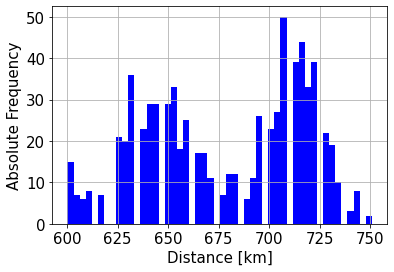

In [36]:
%matplotlib inline
plt.rcParams['font.size'] = 15.0
#Create figure
fig, ax = plt.subplots()

#Save positions of SBJ
sbj_ind = []
sbj_pos = []
for i in range(len(ds_71W_sbj.time_counter.to_numpy())):
    sbj_ind.append(np.where(ds_71W_sbj_cut['u_rot_normal'][i] == ds_71W_sbj_cut['u_rot_normal'][i].min())[1])
    sbj_pos.append(ds_71W_sbj_cut.c[sbj_ind[i]].to_numpy()[0]/1e3)

# sbj_pos
ax.hist(sbj_pos, bins = 50, color = 'blue')
ax.grid()
ax.set_xlabel('Distance [km]')
ax.set_ylabel('Absolute Frequency')

#Save figure
fig.savefig(path_rp + 'DV_NAshelf_NEMO/Plots/Sections/SBJ/71W/hist_sbj_pos.png')

## Average for each year
Reduce data via yearly mean to 'stabilize' determination of SBJ

<IPython.core.display.Javascript object>


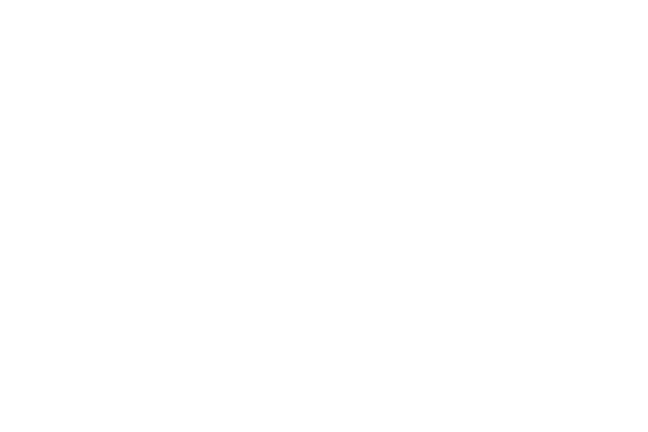

In [37]:
%matplotlib notebook
plt.rcParams['font.size'] = 15.0
ds_71W_sbj_gr = ds_71W_sbj.groupby('time_counter.year').mean(dim = 'time_counter')

ds_71W_sbj_gr_cut = ds_71W_sbj_gr.sel(z = slice(0, 50), c = slice(600*1e3, 1000*1e3))

#Create animation of position of SBJ

#Creating figures
fig, ax = plt.subplots()

#Define observation period
time_begin = '1958'
time_end = '2019'

#Select data from time period
ds_71W_sbj_gr = ds_71W_sbj_gr.sel(year = slice(time_begin, time_end))
ds_71W_sbj_gr_cut = ds_71W_sbj_gr_cut.sel(year = slice(time_begin, time_end))

#Add initial colormesh
cmesh = ax.contourf(ds_71W_sbj_gr.c/1e3, ds_71W_sbj_gr.z, ds_71W_sbj_gr['u_rot_normal'][0], 
                    cmap = cmap, levels = 50, norm = colors.CenteredNorm())
cbar = fig.colorbar(cmesh, ax = ax, location = 'right', label = 'Velocity normal [m/s]', pad = 0.1)

sbj_pos = np.where(ds_71W_sbj_gr_cut['u_rot_normal'][0] == ds_71W_sbj_gr_cut['u_rot_normal'][0].min())
sctt = ax.scatter(ds_71W_sbj_gr_cut.c[sbj_pos[1]]/1e3, ds_71W_sbj_gr_cut.z[sbj_pos[0]], color = 'red', marker = 'x')
ax.invert_xaxis()
ax.invert_yaxis()


def animate(i):
    
    ax.clear()
    cmesh = ax.contourf(ds_71W_sbj_gr.c/1e3, ds_71W_sbj_gr.z, ds_71W_sbj_gr['u_rot_normal'][i], 
                    cmap = cmap, levels = 50, norm = colors.CenteredNorm())
    
    sbj_pos = np.where(ds_71W_sbj_gr_cut['u_rot_normal'][i] == ds_71W_sbj_gr_cut['u_rot_normal'][i].min())
    ax.scatter(ds_71W_sbj_gr_cut.c[sbj_pos[1]]/1e3, ds_71W_sbj_gr_cut.z[sbj_pos[0]], color = 'red', marker = 'x')
    ax.invert_xaxis()
    ax.invert_yaxis()
    ax.set_title('71W: ' + '{}'.format(ds_71W_sbj_gr['year'][i].to_numpy()))
    ax.set_xlabel('Distance [km]')
    ax.set_ylabel('Depth [m]')

anim = FuncAnimation(fig, animate, frames = len(ds_71W_sbj_gr.year.to_numpy()), interval = 1000, blit = False)
anim.save(path_rp + 'DV_NAshelf_NEMO/Plots/Sections/SBJ/71W/sbj_position_yearly.gif', writer='imagemagick', fps=1)


### Histogram of SBJ position - Yearly

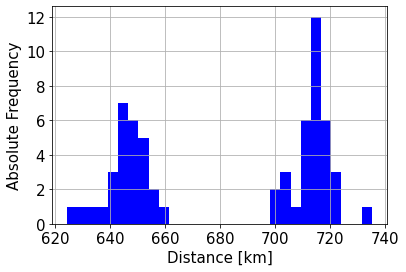

In [38]:
%matplotlib inline
plt.rcParams['font.size'] = 15.0
#Save positions of SBJ
sbj_ind = []
sbj_pos = []
for i in range(len(ds_71W_sbj_gr.year.to_numpy())):
    sbj_ind.append(np.where(ds_71W_sbj_gr_cut['u_rot_normal'][i] == ds_71W_sbj_gr_cut['u_rot_normal'][i].min())[1])
    sbj_pos.append(ds_71W_sbj_gr_cut.c[sbj_ind[i]].to_numpy()[0]/1e3)

# sbj_pos
fig, ax = plt.subplots()
ax.hist(sbj_pos, bins = 30, color = 'blue')
ax.grid()
ax.set_xlabel('Distance [km]')
ax.set_ylabel('Absolute Frequency')

#Save figure
fig.savefig(path_rp + 'DV_NAshelf_NEMO/Plots/Sections/SBJ/71W/hist_sbj_pos_yearly.png')